# **Active Object Localization with Deep Reinforcement Learning**

In [1]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)

1 Physical GPUs, 1 Logical GPUs


**Mounting google drive for accessing dataset:**

In [2]:
from google.colab import files
files.upload()
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json
#rm -rf testing
#Download required dataset / competition files to a folder of your choice
!kaggle datasets download -d huanghanchina/pascal-voc-2012 -p /content/pascal

Saving kaggle.json to kaggle.json
kaggle.json
 99% 3.60G/3.63G [01:07<00:00, 85.0MB/s]
100% 3.63G/3.63G [01:07<00:00, 57.4MB/s]


**Creating folders for saving model and visualized images during test:**

In [0]:
""" It may take some time to extract the dataset zip. Plz be patient ! """
#!pwd
import os
os.chdir('./pascal')  #change dir
!unzip -q pascal-voc-2012.zip

!mkdir models_image_zooms  #create a directory named train/
!mkdir testing_visualizations  #create a directory named test/
!mkdir testing

**Importing essential libraries:**

In [4]:

from keras.initializers import VarianceScaling
from keras.preprocessing import image
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.optimizers import RMSprop, SGD, Adam
import numpy as np
import xml.etree.ElementTree as ET
from keras.applications.vgg16 import VGG16
from PIL import Image, ImageDraw, ImageFont
import cv2
from keras import backend as K
import random
#import tensorflow as tf

Using TensorFlow backend.


**Defining Q network composed of 3 fully connected layers:**

In [0]:
init = VarianceScaling(scale=0.01,mode='fan_in', distribution='normal', seed=None)

def get_q_network(weights_path, class_object, epoch):
    model = Sequential()
    model.add(Dense(1024, kernel_initializer= init, input_shape=(25112,)))
    model.add(Activation('relu'))
    model.add(Dropout(0.2))
    model.add(Dense(1024, kernel_initializer= init))
    model.add(Activation('relu'))
    model.add(Dropout(0.2))
    model.add(Dense(6, kernel_initializer= init))
    model.add(Activation('linear'))
    adam = Adam(lr=1e-6)
    model.compile(loss='mse', optimizer=adam)
    if weights_path != "0":
        model.load_weights(weights_path + "/model" + str(class_object-1) + "_epoch_"+ str(epoch) + ".h5")
    return model

**Extract the name of images from the corresponding txt file:**

In [0]:
def load_images_names_in_data_set(data_set_name, path_voc):
    file_path = path_voc + '/ImageSets/Main/' + data_set_name + '.txt'
    f = open(file_path)
    index_list = []
    image_names = f.readlines()
    for line in image_names:   
      if "-1" not in line.split(" ")[1]:
              index_list.append(line.split(" ")[0])
    return index_list


**Load labels (class of images) from the corresponding txt file:**

In [0]:
def load_images_labels_in_data_set(data_set_name, path_voc):
    file_path = path_voc + '/ImageSets/Main/' + data_set_name + '.txt'
    f = open(file_path)
    images_names = f.readlines()
    images_names = [x.split(None, 1)[1] for x in images_names]
    images_names = [x.strip('\n') for x in images_names]
    return images_names

**Load all images into PIL (Python Imaging Library) format:**

In [0]:
from tensorflow.keras.preprocessing import image
def get_all_images(image_names, path_voc):
    images_ = []
    for j in range(np.size(image_names)):
        image_name = image_names[0][j]
        string = path_voc + '/JPEGImages/' + image_name + '.jpg'
        images_.append(image.load_img(string))
    return images_

**Convert the name of object's class to integers:**

In [0]:
def get_id_of_class_name (class_name):

    dictionary={'aeroplane':1, 'bicycle':2, 'bird':3, 'boat':4, 'bottle':5, 
        'bus':6, 'car':7, 'cat':8, 'chair':9, 'cow':10, 'diningtable':11,
        'dog':12, 'horse':13, 'motorbike':14, 'person':15, 'pottedplant':16,
        'sheep':17, 'sofa':18, 'train':19, 'tvmonitor':20}

    return dictionary[class_name]

**Loading bounding box from xml annotations around objects in images (to be used as the ground truth during training to obtain reward):**

In [0]:
def get_bb_of_gt_from_pascal_xml_annotation(xml_name, voc_path):
    string = voc_path + '/Annotations/' + xml_name + '.xml'
    tree = ET.parse(string)
    root = tree.getroot()
    names = []
    x_min = []
    x_max = []
    y_min = []
    y_max = []
    for child in root:
        if child.tag == 'object':
            for child2 in child:
                if child2.tag == 'name':
                    names.append(child2.text)
                elif child2.tag == 'bndbox':
                    for child3 in child2:
                        if child3.tag == 'xmin':
                            x_min.append(child3.text)
                        elif child3.tag == 'xmax':
                            x_max.append(child3.text)
                        elif child3.tag == 'ymin':
                            y_min.append(child3.text)
                        elif child3.tag == 'ymax':
                            y_max.append(child3.text)
    category_and_bb = np.zeros([np.size(names), 5])
    for i in range(np.size(names)):
        category_and_bb[i][0] = get_id_of_class_name(names[i])
        category_and_bb[i][1] = x_min[i]
        category_and_bb[i][2] = x_max[i]
        category_and_bb[i][3] = y_min[i]
        category_and_bb[i][4] = y_max[i]
    return category_and_bb

**Generate masks to represent bounding boxes on objects in images:**

In [0]:
def generate_bounding_box_from_annotation(annotation, image_shape):
    length_annotation = annotation.shape[0]
    masks = np.zeros([image_shape[0], image_shape[1], length_annotation])
    for i in range(0, length_annotation):
        masks[np.int(annotation[i, 3]):np.int(annotation[i, 4]), np.int(annotation[i, 1]):np.int(annotation[i, 2]), i] = 1
    return masks

**Storing the id of objects' classes separately from bounding box array:**

In [0]:

def get_ids_objects_from_annotation(annotation):
    return annotation[:, 0]

**Calculate overlap between between the target object bounding box and the predicted box:**

In [0]:
def calculate_overlapping(img_mask, gt_mask):
    gt_mask *= 1.0
    #
    img_and = cv2.bitwise_and(img_mask, gt_mask)
    j = np.count_nonzero(img_and)
    i = np.count_nonzero(gt_mask)
    overlap = float(float(j)/float(i))
    return overlap

**Calculate Intersection-over-Union (IoU) between the target object bounding box and the predicted box:**

In [0]:
def calculate_iou(img_mask, gt_mask):
    gt_mask *= 1.0
    img_and = cv2.bitwise_and(img_mask, gt_mask)
    img_or = cv2.bitwise_or(img_mask, gt_mask)
    j = np.count_nonzero(img_and)
    i = np.count_nonzero(img_or)
    iou = float(float(j)/float(i))
    return iou

**Check if the predicted box has more overlap with another target object and define a new IoU for the new target:**

In [0]:
def follow_iou(gt_masks, mask, array_classes_gt_objects, object_id, last_matrix, available_objects):
    results = np.zeros([np.size(array_classes_gt_objects), 1])
    for k in range(np.size(array_classes_gt_objects)):
        if array_classes_gt_objects[k] == object_id:
            if available_objects[k] == 1:
                gt_mask = gt_masks[:, :, k]
                iou = calculate_iou(mask, gt_mask)
                results[k] = iou
            else:
                results[k] = -1
    max_result = max(results)
    ind = np.argmax(results)
    iou = last_matrix[ind]
    new_iou = max_result
    return iou, new_iou, results, ind

**Extracting Features from images using pre-trained VGG16:**

In [0]:
from keras import backend as K
def get_conv_image_descriptor_for_image(image_1, model):
    im = cv2.resize(image_1, (224, 224)).astype(np.float32)
    dim_ordering = K.image_data_format()
    if dim_ordering == 'channels_first':
        # 'RGB'->'BGR'
        im = im[::-1, :, :]
        # Zero-center by mean pixel
        im[0, :, :] -= 103.939
        im[1, :, :] -= 116.779
        im[2, :, :] -= 123.68
    else:
        # 'RGB'->'BGR'
        im = im[:, :, ::-1]
        # Zero-center by mean pixel
        im[:, :, 0] -= 103.939
        im[:, :, 1] -= 116.779
        im[:, :, 2] -= 123.68
    #im = im.transpose((2, 0, 1))
    im = np.expand_dims(im, axis=0)
    #_convout1_f = K.function(model.layers[0].input, K.learning_phase()],[self.model.layers[-1].output])
    inputs = [K.learning_phase()] + model.inputs
    _convout1_f = K.function(inputs, [model.layers[19].output])
    
    return _convout1_f([0] + [im])

**compute the current state from decriptor of image and history of actions:**

In [0]:
# Different actions that the agent can do
number_of_actions = 6
# Actions captured in the history vector
actions_of_history = 4
# Visual descriptor size
visual_descriptor_size = 25088

def get_state(image_1, history_vector, model_vgg):
    descriptor_image = get_conv_image_descriptor_for_image(image_1, model_vgg)
    descriptor_image = np.reshape(descriptor_image, (visual_descriptor_size, 1))
    history_vector = np.reshape(history_vector, (number_of_actions*actions_of_history, 1))
    state = np.vstack((descriptor_image, history_vector))
    return state



**Updating the action history:**

In [0]:

def update_history_vector(history_vector, action):
    action_vector = np.zeros(number_of_actions)
    action_vector[action-1] = 1
    size_history_vector = np.size(np.nonzero(history_vector))
    updated_history_vector = np.zeros(number_of_actions*actions_of_history)
    if size_history_vector < actions_of_history:
        aux2 = 0
        for l in range(number_of_actions*size_history_vector, number_of_actions*size_history_vector+number_of_actions - 1):
            history_vector[l] = action_vector[aux2]
            aux2 += 1
        return history_vector
    else:
        for j in range(0, number_of_actions*(actions_of_history-1) - 1):
            updated_history_vector[j] = history_vector[j+number_of_actions]
        aux = 0
        for k in range(number_of_actions*(actions_of_history-1), number_of_actions*actions_of_history):
            updated_history_vector[k] = action_vector[aux]
            aux += 1
        return updated_history_vector

**Action id to string:**

In [0]:
def string_for_action(action):
  
    dictionary={ 0:"START", 1:'up-left', 2:'up-right',
                3:'down-left', 4:'down-right', 5:'center',
                6:'TRIGGER'}

    return dictionary[action]

**Visualization of predicted and target bounding boxes:**

In [0]:
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
path_font = "/usr/share/fonts/liberation/LiberationMono-Regular.ttf"
font = ImageFont.truetype(path_font, 24)

def draw_sequences_test(step, action, qval, draw, region_image, background, path_testing_folder,
                        region_mask, image_name, save_boolean):
    if not save_boolean == 1:
        return
    aux = np.asarray(region_image, np.uint8)
    img_offset = (1000 * step, 70)
    footnote_offset = (1000 * step, 550)
    q_predictions_offset = (1000 * step, 500)
    mask_img_offset = (1000 * step, 700)

    img_for_paste = Image.fromarray(aux)
    background.paste(img_for_paste, img_offset)

    mask_img = Image.fromarray(255 * region_mask)
    background.paste(mask_img, mask_img_offset)

    footnote = 'action: ' + str(string_for_action(action))
    print(footnote)
    nice = []

    for q_value in qval[0]:
        nice.append(round(q_value, 3))

    q_val_predictions_text = str(nice)
    # draw.text(footnote_offset, footnote, (0, 0, 0))
    # draw.text(q_predictions_offset, q_val_predictions_text, (0, 0, 0))
    draw.text(footnote_offset, footnote, (0, 0, 0), font=font)
    draw.text(q_predictions_offset, q_val_predictions_text, (0, 0, 0), font=font)
    file_name = path_testing_folder + '/' + image_name + '.png'
    #background.save(file_name)

    return background

def draw_sequences_test_box(draw, background, box_area, box_color, path_testing_folder, image_name, save_boolean, finish_step, line_width):
    if not save_boolean == 1:
        return

    draw.rectangle(box_area, outline=box_color,width=line_width)
    if finish_step:
      plt.figure(figsize=(5,8))
      plt.imshow(background)
      plt.show()
    file_name = path_testing_folder + '/' + image_name + 'with_box.png'
    background.save(file_name)

**Calculating terminal action reward (for trigger action):**

In [0]:
# Reward terminal action
reward_terminal_action = 3
iou_threshold = 0.5

def get_reward_trigger(new_iou):
    if new_iou > iou_threshold:
        reward = reward_terminal_action
    else:
        reward = - reward_terminal_action
    return reward

**Calculating other actions reward (for changing the predicted box around object):**

In [0]:
# Reward movement action
reward_movement_action = 1

def get_reward_movement(iou, new_iou):
    if new_iou > iou:
        reward = reward_movement_action
    else:
        reward = - reward_movement_action
    return reward

**Masking the object found with ground-truth bounding box to avoid detecting the same object recursively:**

In [0]:
def mask_image_with_mean_background(mask_object_found, image_1):
    new_image = image_1
    size_image = np.shape(mask_object_found)
    for j in range(size_image[0]):
        for i in range(size_image[1]):
            if mask_object_found[j][i] == 1:
                    new_image[j, i, 0] = 103.939
                    new_image[j, i, 1] = 116.779
                    new_image[j, i, 2] = 123.68
    return new_image

**Training target Network to estimate target values:**

In [0]:
def target_train(model, target_model,target_tau):
    weights = model.get_weights()
    target_weights = target_model.get_weights()
    for i in range(len(target_weights)):
        target_weights[i] = weights[i] * target_tau + target_weights[i] * (1 - target_tau)
    target_model.set_weights(target_weights)
    return target_model

In [25]:
from google.colab import drive
drive.mount('/content/gdrive' , force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


**Testing the agent:**

553467904/553467096 [==============================] - 12s 0us/step
action: START
action: center
action: center
action: TRIGGER


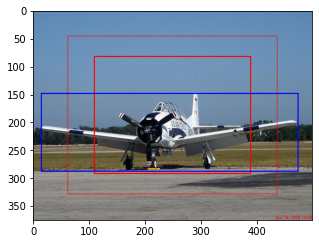

0.46716541978387366
action: START
action: TRIGGER


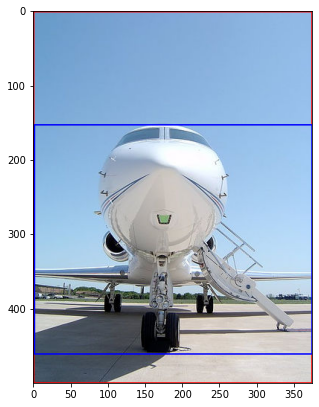

0.616352
action: START
action: TRIGGER
0.53075


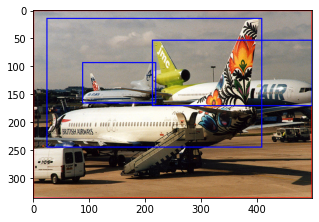

action: START
action: up-left
action: up-left
action: TRIGGER


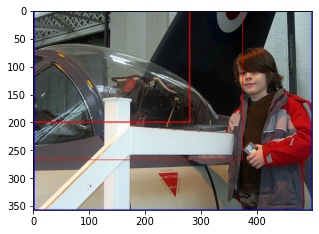

0.31281579124654735
action: START
action: center
action: TRIGGER


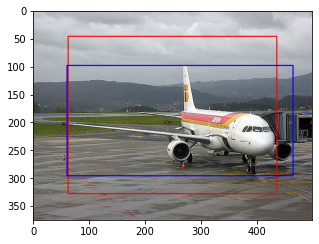

0.6636100386100386
action: START
action: TRIGGER


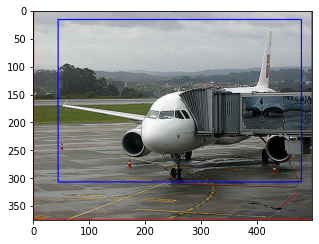

0.678224
action: START
action: TRIGGER


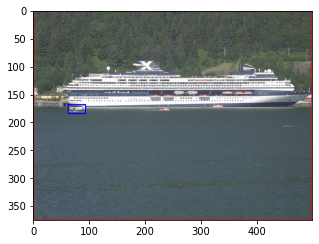

0.0029013333333333335
action: START
action: up-left
action: up-left
action: up-right
action: up-left
action: up-left
action: down-right
action: down-right
action: down-left
action: down-left
action: down-left
action: down-left


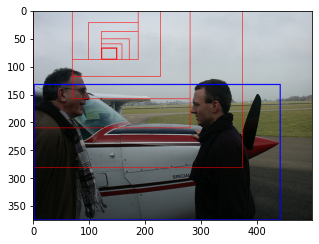

0.0
action: START
action: up-left
action: down-left
action: up-left
action: up-left
action: up-left
action: up-left
action: TRIGGER


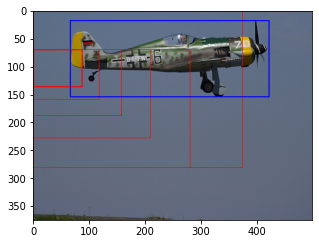

0.027638709193527216
action: START
action: down-left
action: TRIGGER


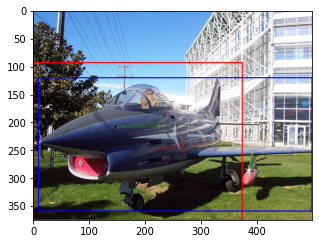

0.6449695852534563
action: START
action: TRIGGER


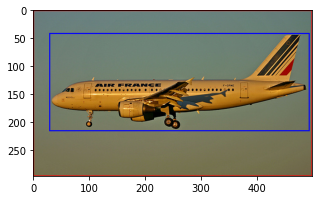

0.5491582491582492
action: START
action: TRIGGER


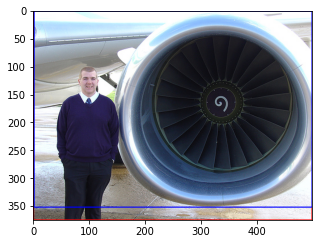

0.934128
action: START
action: center
action: center
action: center
action: center
action: center
action: center
action: center
action: center
action: TRIGGER


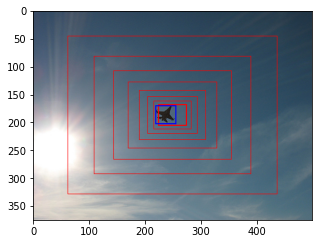

0.5021398002853067
action: START
action: TRIGGER


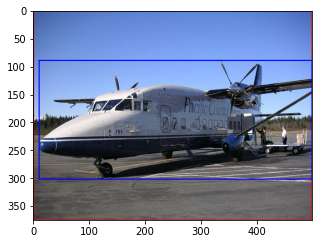

0.55664
action: START
action: center
action: center
action: center
action: down-right
action: down-right
action: TRIGGER


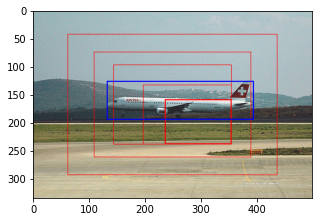

0.1832100243766839
action: START
action: center
action: up-left
action: up-left
action: center
action: center
action: TRIGGER
0.044676098287416234


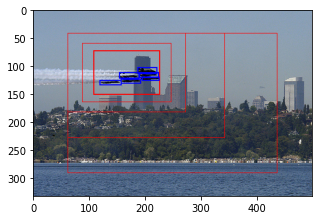

action: START
action: up-right
action: center
action: TRIGGER


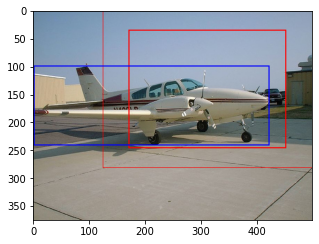

0.42782334233997277
action: START
action: center
action: down-left
action: TRIGGER


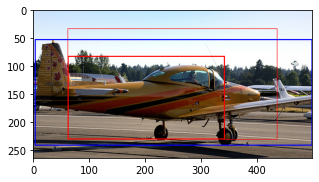

0.4433866356030922
action: START
action: center
action: down-right
action: down-left
action: down-right
action: down-right
action: TRIGGER


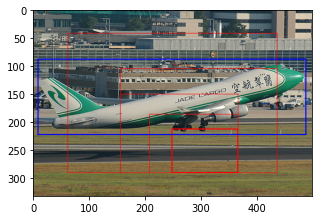

0.017807585568917667
action: START
action: up-right
action: down-left
action: TRIGGER


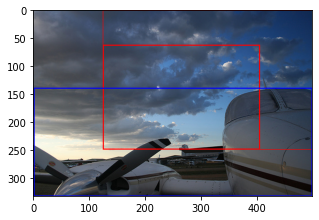

0.2609694114468563
action: START
action: center
action: center
action: up-right
action: down-left
action: down-right
action: TRIGGER
0.4137800132865142


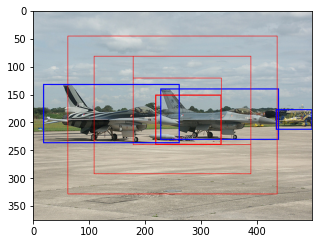

action: START
action: up-left
action: center
action: center
action: up-left
action: TRIGGER
0.1054249547920434


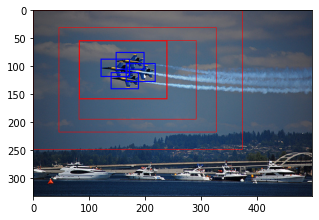

action: START
action: TRIGGER


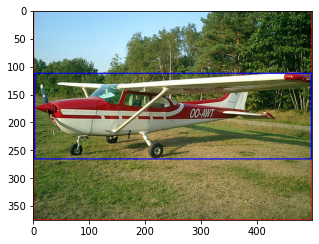

0.40820266666666666
action: START
action: down-left
action: TRIGGER
0.5704460966542751


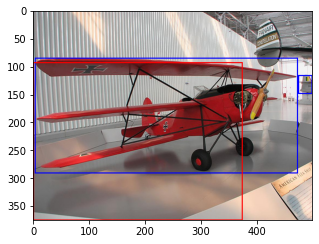

action: START
action: TRIGGER


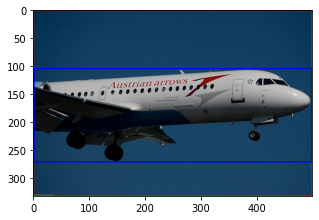

0.5034954954954955
action: START
action: TRIGGER


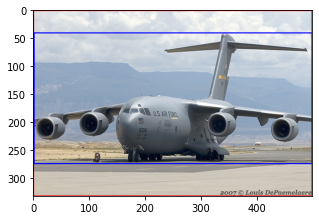

0.7042942942942942
action: START
action: up-left
action: center
action: center
action: center
action: down-right
action: down-right
action: down-left
action: down-right
action: down-right
action: down-left
action: down-left
0.016422287390029325


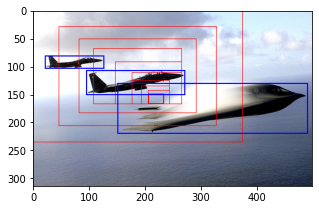

action: START
action: center
action: down-right
action: TRIGGER
0.29295443080544814


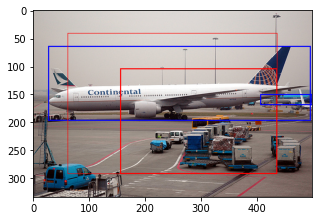

action: START
action: center
action: TRIGGER


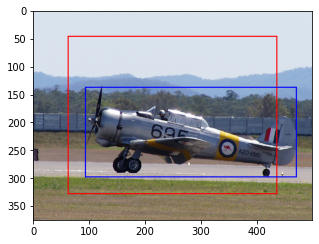

0.49723032724334515
action: START
action: TRIGGER


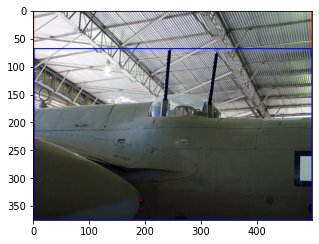

0.8170293333333334
action: START
action: TRIGGER


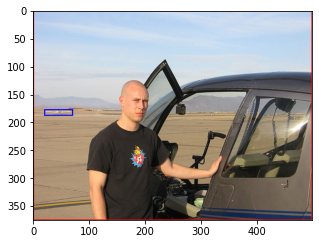

0.002992
action: START
action: center
action: center
action: TRIGGER


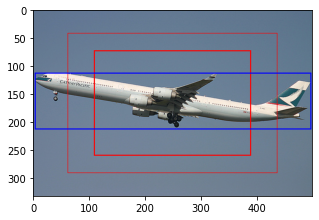

0.38124983208403856
action: START
action: TRIGGER


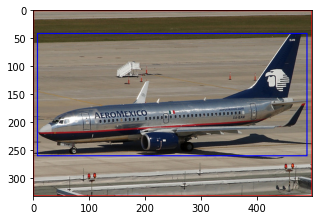

0.6395195195195196
action: START
action: center
action: TRIGGER


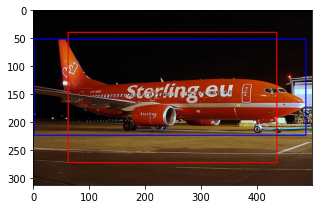

0.6046188687685813
action: START
action: center
action: down-right
action: down-right
action: TRIGGER


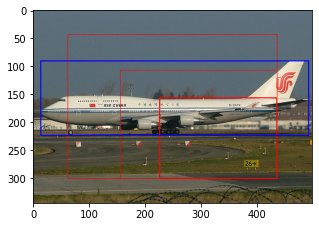

0.17779209675220878
action: START
action: up-left
action: up-right
action: TRIGGER
0.06990209000188288


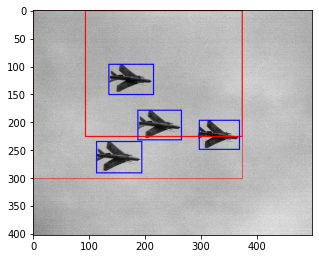

action: START
action: down-left
action: center
action: center
action: TRIGGER


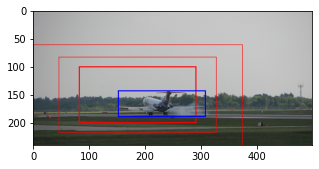

0.29896860375301015
action: START
action: up-right
action: TRIGGER


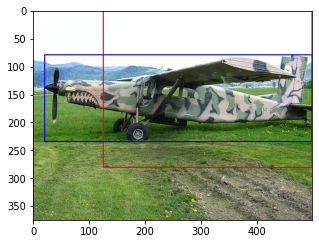

0.4804730811876309
action: START
action: TRIGGER


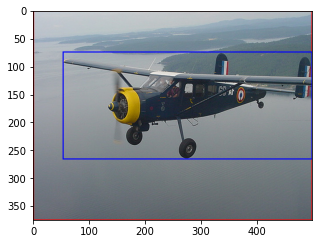

0.457728
action: START
action: up-left
action: down-right
action: up-left
action: TRIGGER


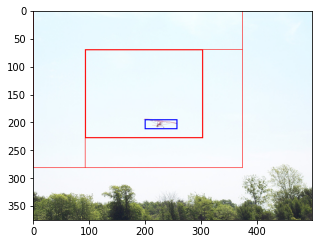

0.029575859379686844
action: START
action: center
action: up-right
action: down-left
action: TRIGGER
0.3911002272973266


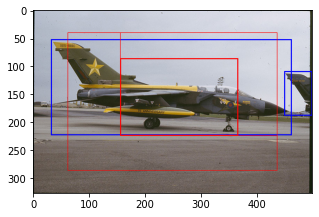

action: START
action: center
action: TRIGGER


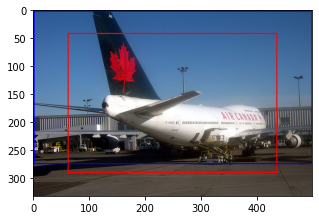

0.6148143996188501
action: START
action: TRIGGER
0.8055735735735736


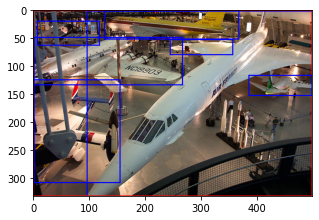

action: START
action: TRIGGER


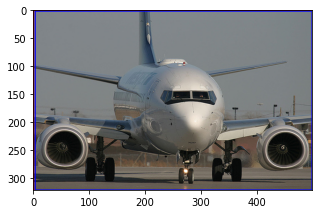

0.9909130434782609
action: START
action: center
action: center
action: center
action: TRIGGER


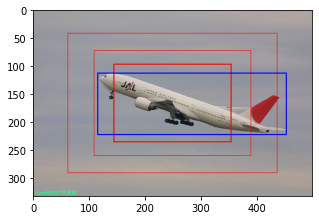

0.5353616165310414
action: START
action: center
action: up-left
action: center
action: TRIGGER


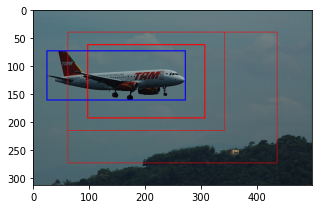

0.45602492066726835
action: START
action: TRIGGER


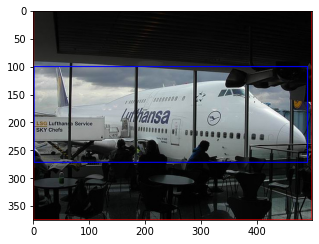

0.4504106666666667
action: START
action: center
action: center
action: center
action: center
action: TRIGGER


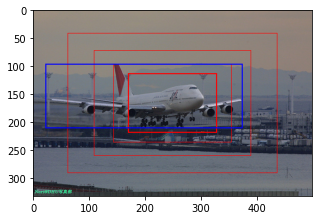

0.3721785654572814
action: START
action: center
action: up-left
action: center
action: center
action: TRIGGER
0.05961422543701025


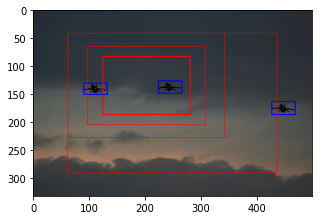

action: START
action: center
action: center
action: center
action: down-left
action: down-left
action: down-left
action: down-right
action: down-left
action: TRIGGER


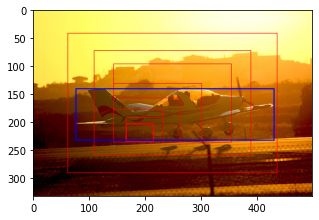

0.04510193036261952
action: START
action: TRIGGER


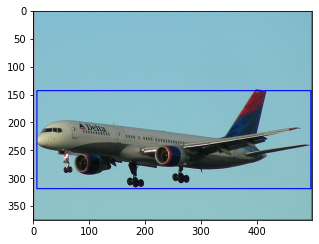

0.461824
action: START
action: TRIGGER


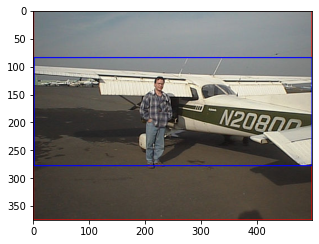

0.5162986666666667
action: START
action: center
action: TRIGGER


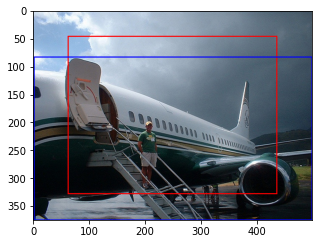

0.5757192182124662
action: START
action: center
action: TRIGGER


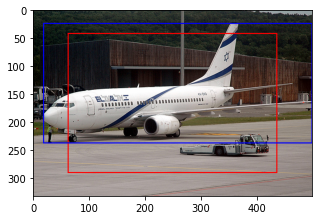

0.598153920893891
action: START
action: center
action: center
action: TRIGGER


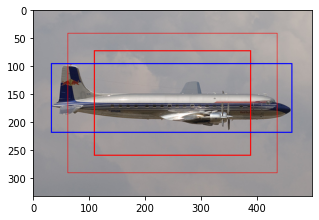

0.48697450805008946
action: START
action: center
action: TRIGGER


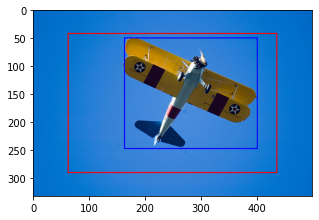

0.5073173333333333
action: START
action: down-left
action: down-left
action: down-left
action: TRIGGER


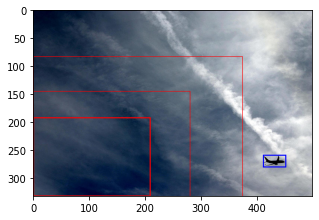

0.0
action: START
action: TRIGGER
0.985139175257732


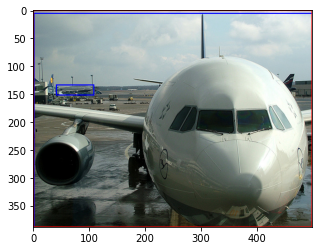

action: START
action: center
action: center
action: center
action: center
action: TRIGGER


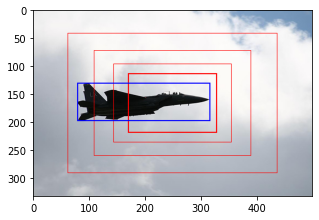

0.4338165089835952
action: START
action: TRIGGER


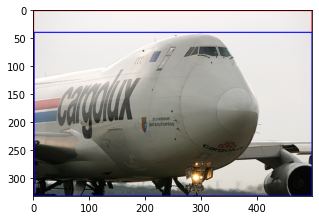

0.8811171171171172
action: START
action: up-left
action: up-left
action: down-right
action: up-left
action: down-right
action: down-right
action: down-right
action: TRIGGER
0.0


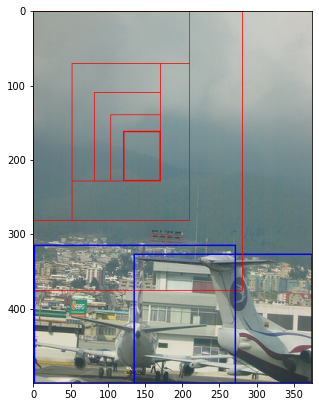

action: START
action: down-left
action: TRIGGER
0.3411330993600142


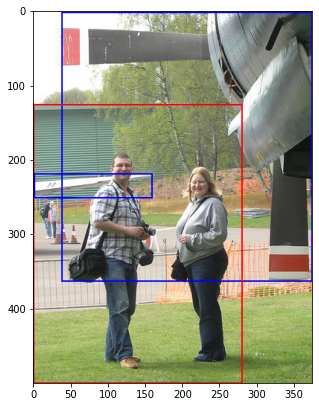

action: START
action: TRIGGER


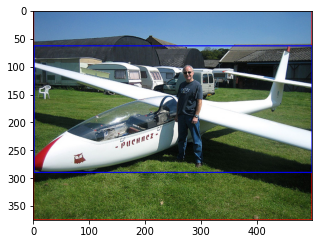

0.6041226666666667
action: START
action: center
action: TRIGGER


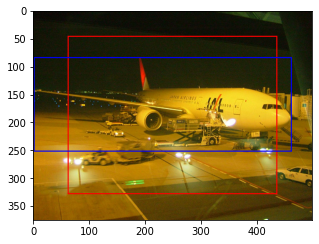

0.5234036189621654
action: START
action: center
action: TRIGGER


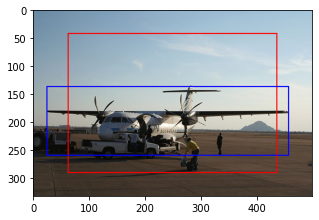

0.4600953832149289
action: START
action: center
action: center
action: center
action: center
action: center
action: TRIGGER


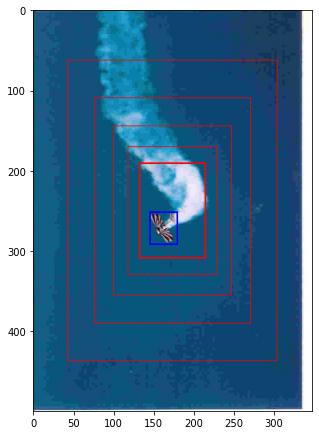

0.14528703047484054
action: START
action: center
action: TRIGGER


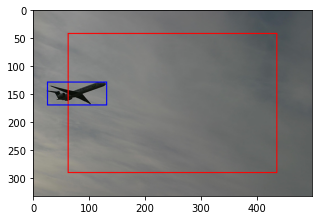

0.030848652732309242
action: START
action: TRIGGER


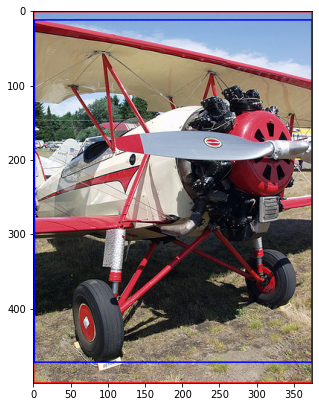

0.9195413333333333
action: START
action: up-right
action: TRIGGER
0.3305715049353474


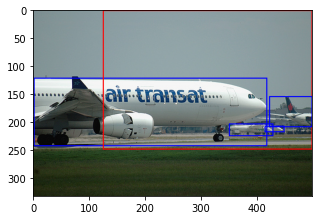

action: START
action: TRIGGER


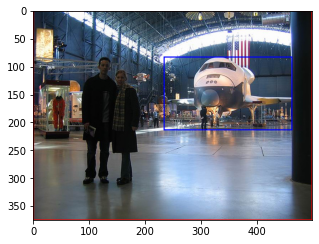

0.16069333333333333
action: START
action: TRIGGER
0.08648048048048049


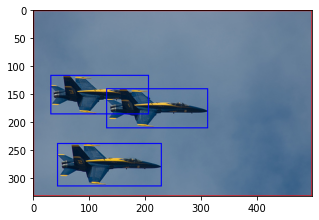

action: START
action: center
action: center
action: down-right
action: up-right
action: TRIGGER
0.3586750057910586


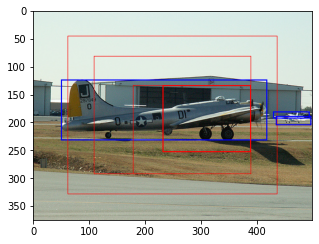

action: START
action: TRIGGER


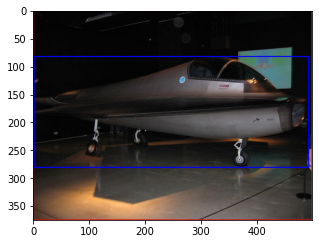

0.5232373333333333
action: START
action: center
action: center
action: down-right
action: TRIGGER


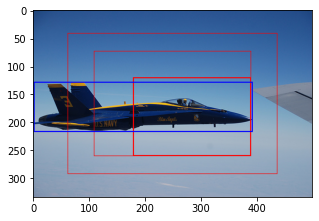

0.4113781243838857
action: START
action: down-left
action: down-left
action: down-right
action: down-left
action: TRIGGER


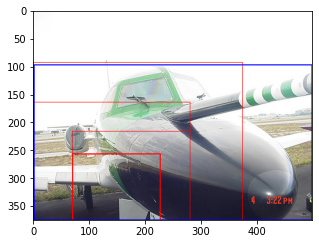

0.13553726157350673
action: START
action: center
action: TRIGGER


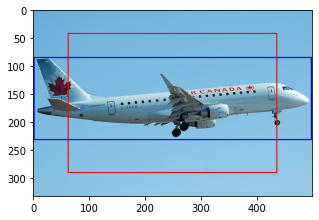

0.4957393215070475
action: START
action: TRIGGER


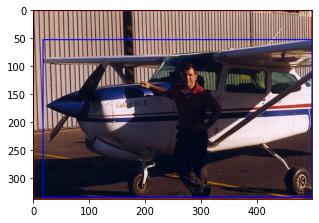

0.808810650887574
action: START
action: TRIGGER
0.5797597597597598


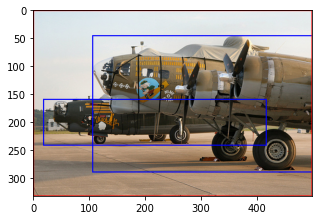

action: START
action: center
action: center
action: center
action: down-left
action: down-right
action: TRIGGER


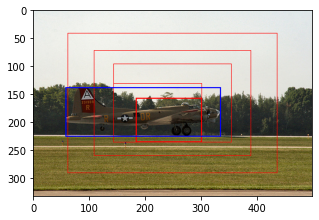

0.3175011698642957
action: START
action: center
action: center
action: down-left
action: TRIGGER
0.3431871876150111


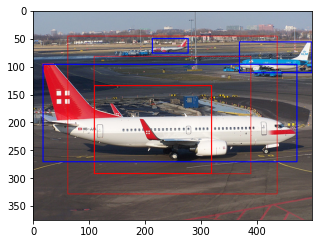

action: START
action: TRIGGER


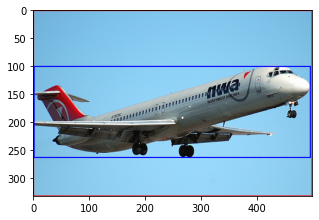

0.48855255255255253
action: START
action: center
action: center
action: down-right
action: down-right
action: down-left
action: up-left
action: up-left
action: down-right
action: TRIGGER


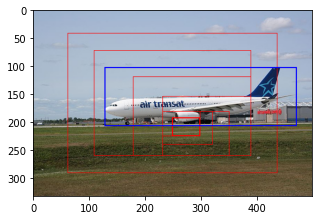

0.02025931928687196
action: START
action: TRIGGER


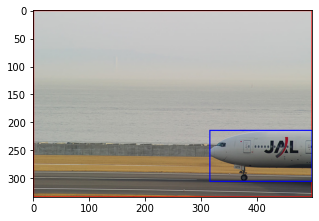

0.10136526946107785
action: START
action: TRIGGER
0.38422712933753944


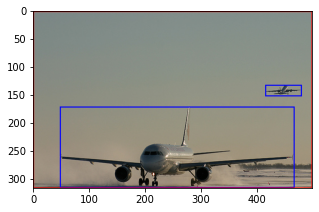

action: START
action: TRIGGER


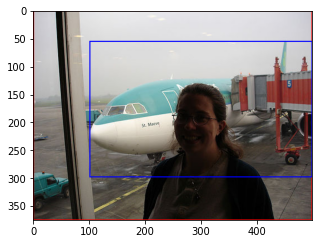

0.517104
action: START
action: center
action: TRIGGER
0.533855325206869


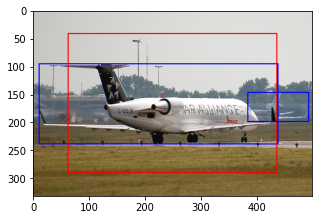

action: START
action: TRIGGER


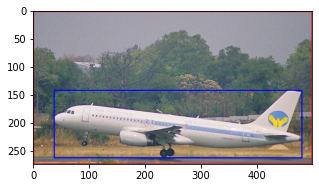

0.3962773722627737
action: START
action: TRIGGER


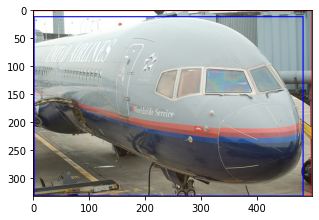

0.9340900900900901
action: START
action: center
action: center
action: center
action: center
action: TRIGGER


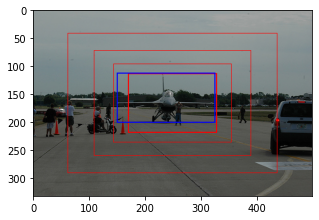

0.7306013837147419
action: START
action: center
action: center
action: up-left
action: TRIGGER


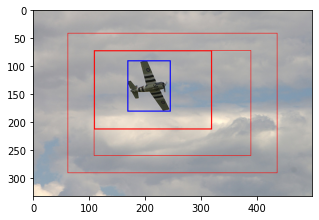

0.23552149507579578
action: START
action: TRIGGER
0.8863614457831326


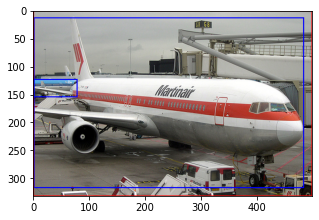

action: START
action: center
action: center
action: down-left
action: down-left
action: down-left
action: TRIGGER


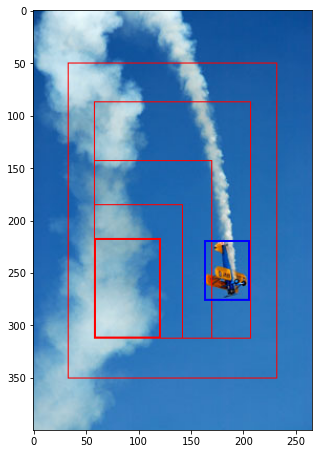

0.0
action: START
action: TRIGGER


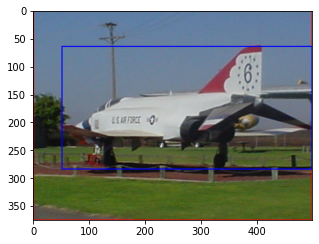

0.5268266666666667
action: START
action: center
action: center
action: TRIGGER


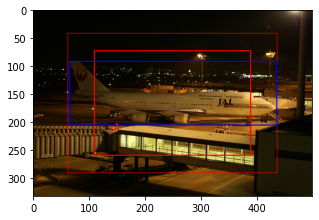

0.5105619894775094
action: START
action: up-left
action: up-left
action: up-left
action: TRIGGER


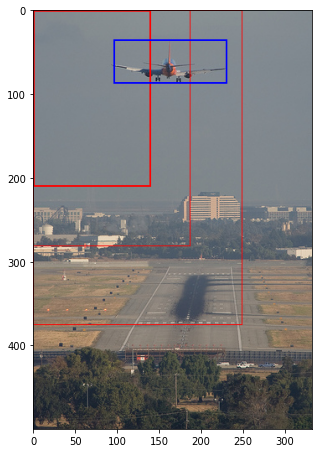

0.06703386851048869
action: START
action: TRIGGER


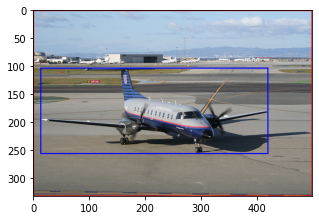

0.3773693693693694
action: START
action: up-left
action: down-right
action: TRIGGER


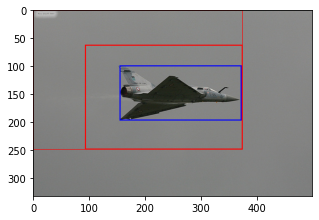

0.4051276216482725
action: START
action: up-left
action: down-right
action: center
action: up-right
action: down-right
action: TRIGGER


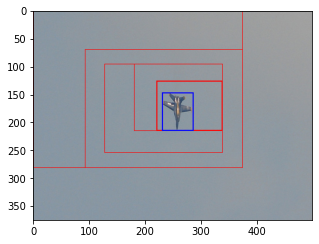

0.3625976004570558
action: START
action: center
action: up-right
action: TRIGGER


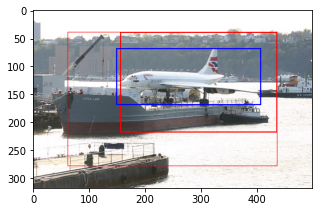

0.4990001176332196
action: START
action: TRIGGER


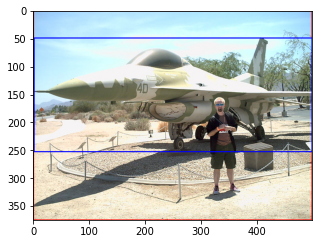

0.542912
action: START
action: center
action: TRIGGER
0.33178389756183124


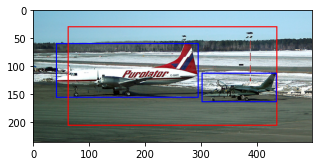

action: START
action: up-right
action: TRIGGER


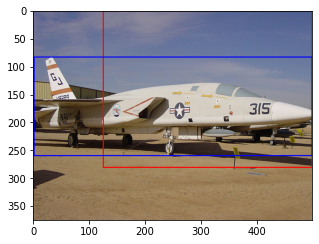

0.521311938926981
action: START
action: TRIGGER


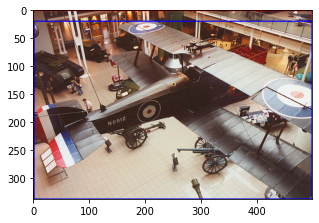

0.9418994082840236
action: START
action: center
action: center
action: up-left
action: up-left
action: up-left
action: up-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
0.0


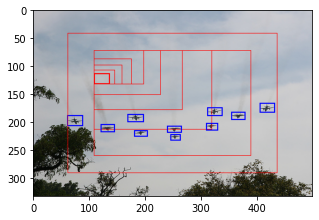

action: START
action: center
action: center
action: center
action: down-left
action: TRIGGER


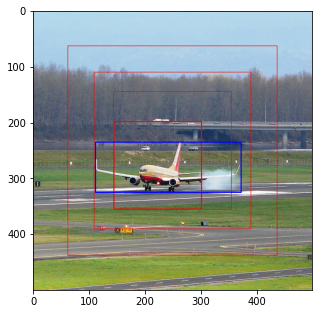

0.4176251887998141
action: START
action: TRIGGER


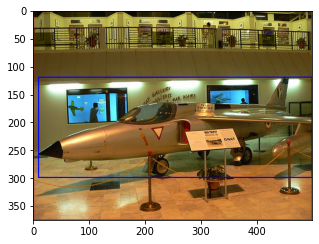

0.47136
action: START
action: up-left
action: TRIGGER


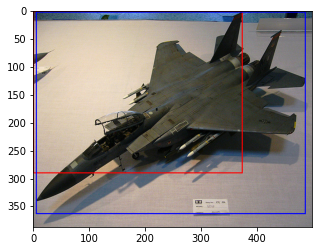

0.6052664349676791
action: START
action: up-left
action: center
action: center
action: down-right
action: TRIGGER


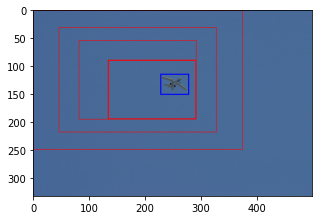

0.11267016957248627
action: START
action: up-left
action: up-left
action: up-left
action: down-right
action: TRIGGER
0.0


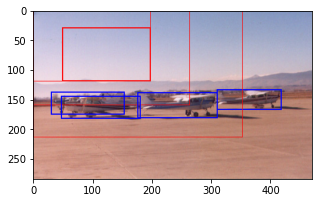

action: START
action: TRIGGER


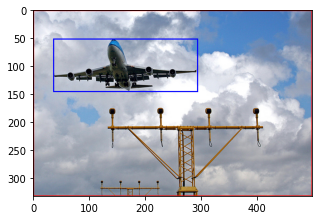

0.14777777777777779
action: START
action: up-left
action: down-left
action: up-left
action: up-left
action: TRIGGER


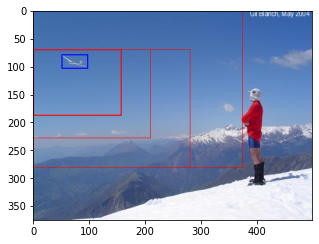

0.06302295644711435
action: START
action: up-left
action: down-right
action: up-right
action: up-left
action: down-right
action: down-right
action: down-right
action: down-left
action: down-left
action: down-left
action: down-left


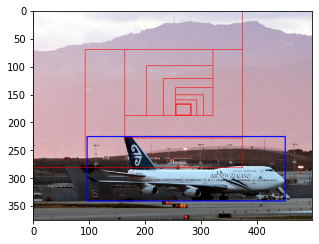

0.0
action: START
action: TRIGGER
0.7042942942942942


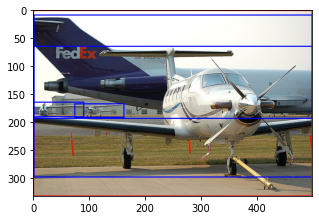

action: START
action: center
action: center
action: up-right
action: TRIGGER


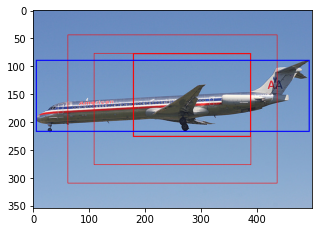

0.4021980313025867
action: START
action: center
action: center
action: down-right
action: down-right
action: up-left
action: down-right
action: down-right
action: up-left
action: up-left
action: up-left
action: up-left


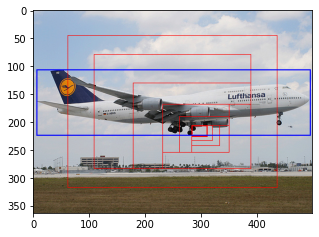

0.008690554195261579
action: START
action: TRIGGER


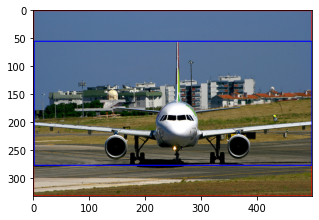

0.6683303303303303
action: START
action: center
action: up-left
action: TRIGGER


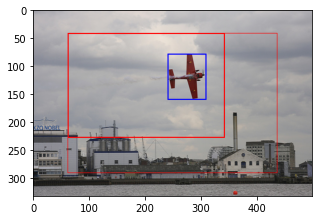

0.10767503377928331
action: START
action: up-left
action: up-left
action: up-left
action: up-right
action: down-right
action: down-right
action: down-left
action: TRIGGER
0.29971455756422455


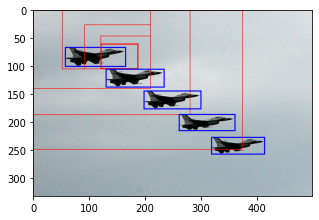

action: START
action: TRIGGER


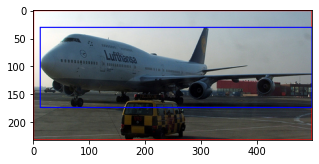

0.6057931034482759
action: START
action: center
action: center
action: TRIGGER


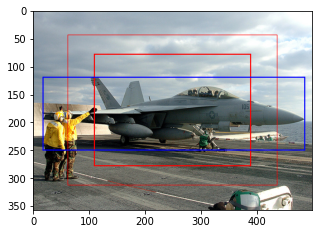

0.4546869403031164
action: START
action: TRIGGER


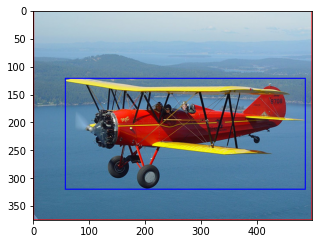

0.45743466666666666
action: START
action: center
action: center
action: down-right
action: down-right
action: up-left
action: TRIGGER


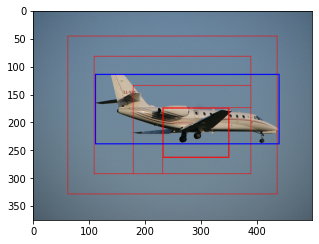

0.17537296512946085
action: START
action: center
action: center
action: TRIGGER


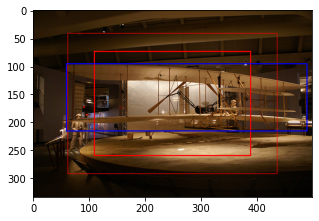

0.4801180490835663
action: START
action: TRIGGER


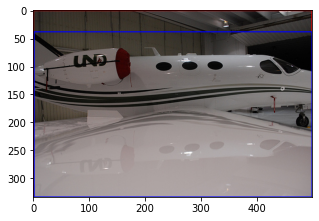

0.8844550898203593
action: START
action: center
action: center
action: center
action: down-right
action: TRIGGER


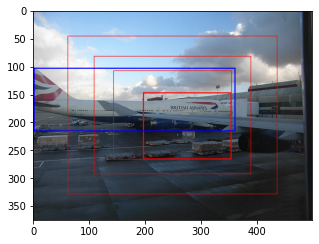

0.22389255129073996
action: START
action: up-left
action: up-left
action: up-left
action: TRIGGER


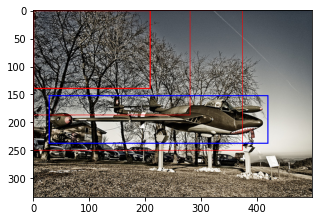

0.0
action: START
action: center
action: center
action: TRIGGER


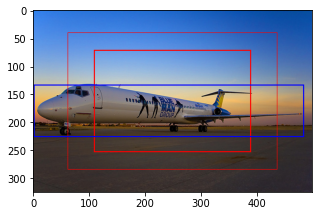

0.37321660644663746
action: START
action: center
action: up-right
action: up-right
action: up-left
action: down-right
action: down-right
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left


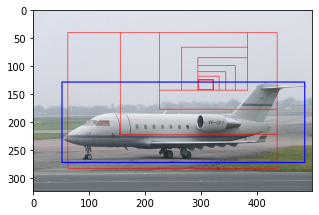

0.006631718562496052
action: START
action: center
action: TRIGGER


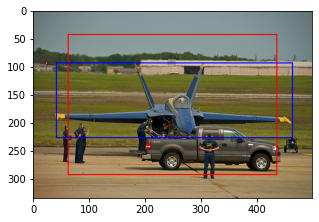

0.5006675567423231
action: START
action: TRIGGER


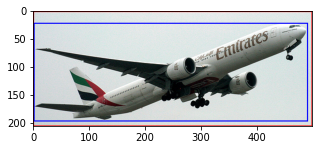

0.8389902912621359
action: START
action: center
action: center
action: center
action: center
action: down-right
action: down-left
action: TRIGGER


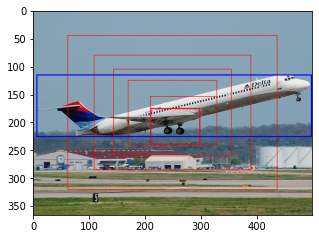

0.08109846522181922
action: START
action: center
action: center
action: down-right
action: down-right
action: down-left
action: up-left
action: up-left
action: up-left
action: TRIGGER


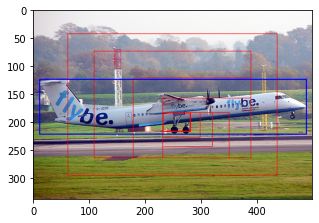

0.03584909639189389
action: START
action: center
action: center
action: TRIGGER
0.4425872643295222


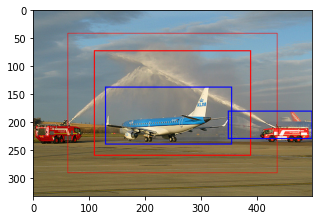

action: START
action: center
action: center
action: center
action: center
action: TRIGGER


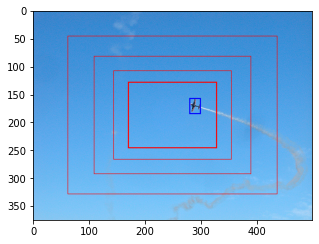

0.02984756422556231
action: START
action: up-left
action: TRIGGER
0.22785619495717216


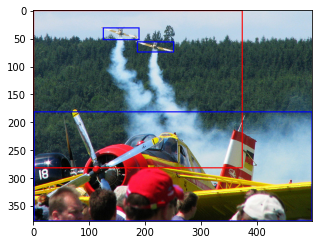

action: START
action: up-left
action: up-left
action: up-left
action: TRIGGER


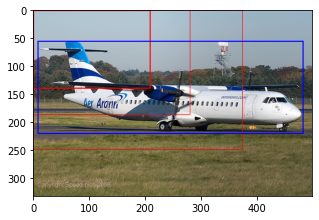

0.18817263222497424
action: START
action: center
action: up-right
action: up-right
action: up-right
action: up-right
action: up-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left


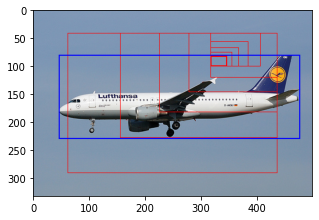

0.008055555555555555
action: START
action: center
action: center
action: center
action: TRIGGER


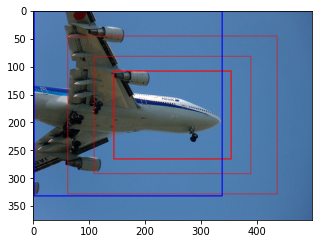

0.2693040574795028
action: START
action: center
action: center
action: TRIGGER


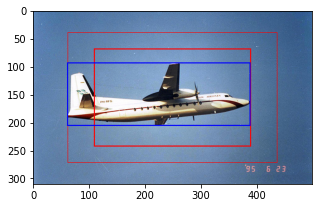

0.5794977929998718
action: START
action: TRIGGER


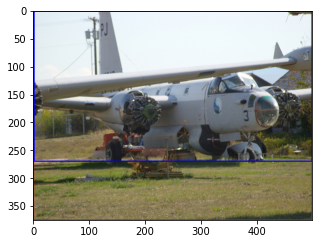

0.7158986666666667
action: START
action: down-left
action: TRIGGER


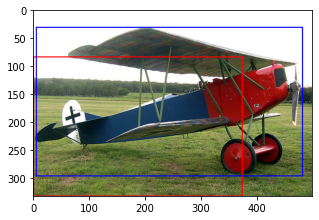

0.5568370418295874
action: START
action: TRIGGER
0.995003003003003


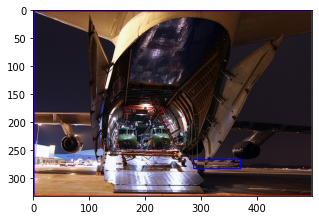

action: START
action: up-left
action: center
action: center
action: down-left
action: TRIGGER


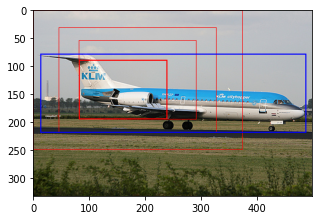

0.24953811311758747
action: START
action: TRIGGER


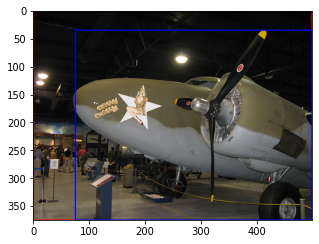

0.7706666666666667
action: START
action: center
action: down-right
action: up-right
action: TRIGGER


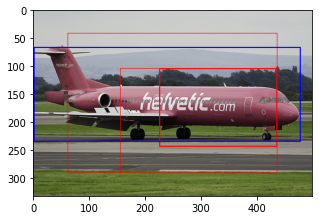

0.33430897062202924
action: START
action: center
action: down-left
action: TRIGGER


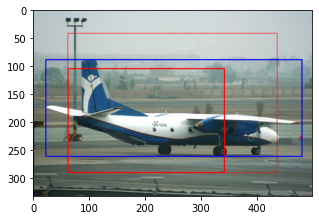

0.5034414722924628
action: START
action: TRIGGER
0.568018018018018


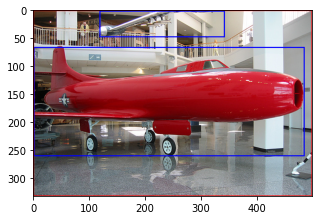

action: START
action: down-right
action: TRIGGER


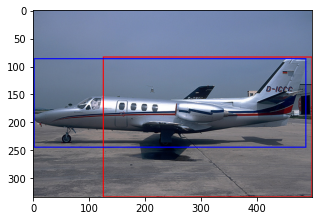

0.5083932853717026
action: START
action: TRIGGER
0.5932307692307692


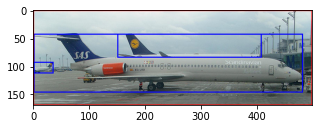

action: START
action: center
action: center
action: TRIGGER


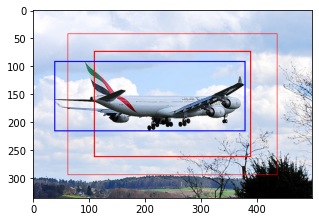

0.5465120030975735
action: START
action: center
action: up-left
action: TRIGGER


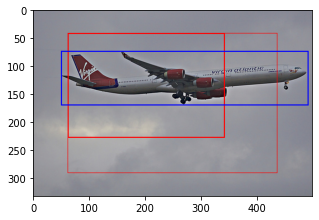

0.3993056064224081
action: START
action: TRIGGER


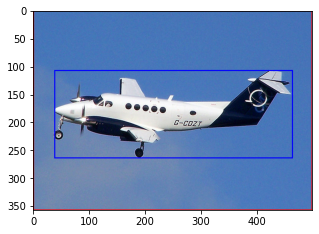

0.3755686274509804
action: START
action: up-left
action: up-right
action: center
action: up-right
action: center
action: TRIGGER


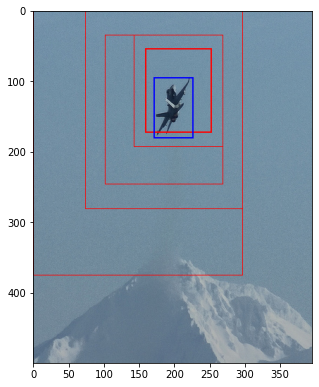

0.37545126353790614
action: START
action: center
action: up-right
action: down-right
action: down-left
action: center
action: TRIGGER


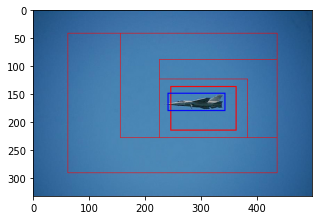

0.3307319130985024
action: START
action: TRIGGER


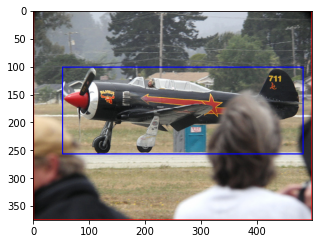

0.359424
action: START
action: center
action: center
action: down-left
action: up-left
action: center
action: down-left
action: TRIGGER


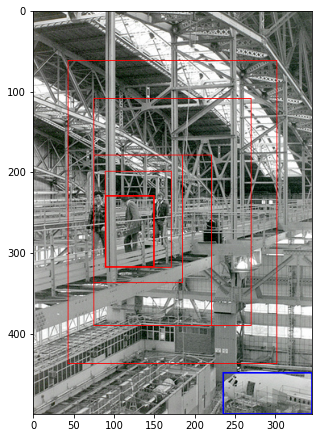

0.0
action: START
action: TRIGGER


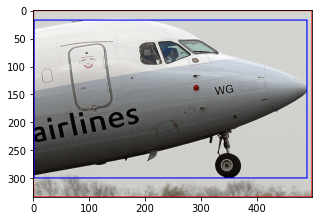

0.8303592814371258
action: START
action: down-right
action: TRIGGER


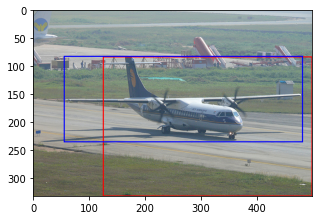

0.5222141713065365
action: START
action: center
action: down-right
action: down-right
action: up-left
action: down-left
action: up-left
action: up-right
action: down-left
action: TRIGGER


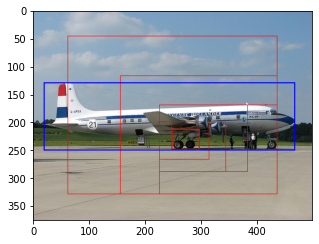

0.03397612488521579
action: START
action: up-left
action: TRIGGER
0.11652014171368587


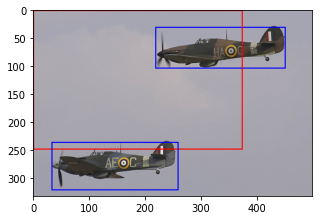

action: START
action: TRIGGER


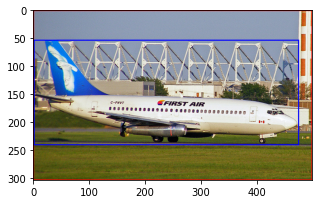

0.5875
action: START
action: center
action: TRIGGER


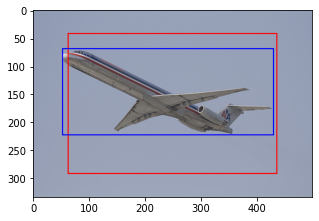

0.5978050692448393
action: START
action: center
action: TRIGGER


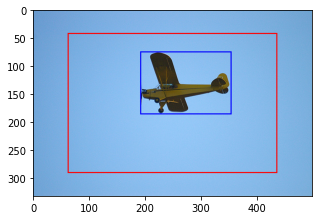

0.19473066666666666
action: START
action: up-left
action: up-right
action: down-right
action: center
action: center
action: TRIGGER


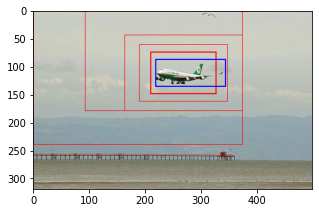

0.5515852525043892
action: START
action: TRIGGER


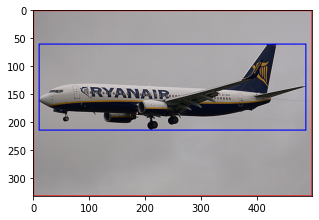

0.4459159159159159
action: START
action: center
action: TRIGGER


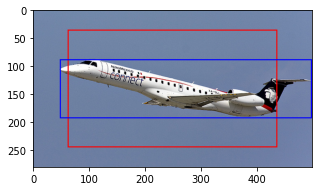

0.4539951573849879
action: START
action: TRIGGER


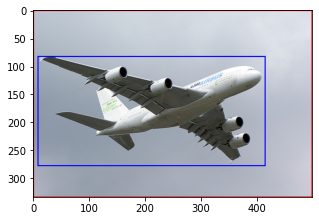

0.4788502994011976
action: START
action: TRIGGER


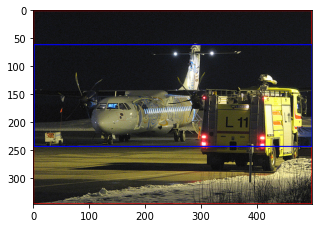

0.5263227665706052
action: START
action: down-right
action: TRIGGER
0.4263670499882657


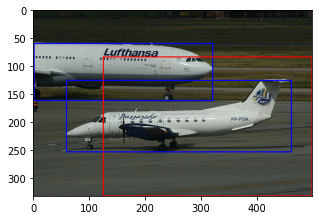

action: START
action: center
action: center
action: TRIGGER


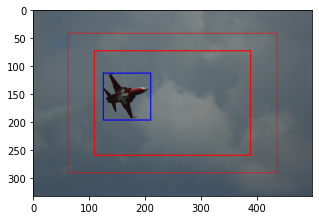

0.13837358976300446
action: START
action: TRIGGER


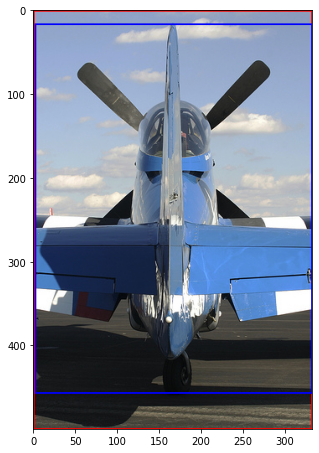

0.8767027027027027
action: START
action: center
action: TRIGGER
0.333935088889761


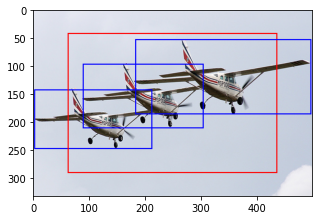

action: START
action: center
action: center
action: center
action: center
action: up-left
action: up-left
action: up-left
action: TRIGGER
0.04871939888502868


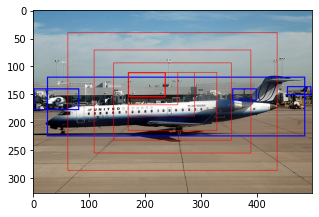

action: START
action: center
action: TRIGGER


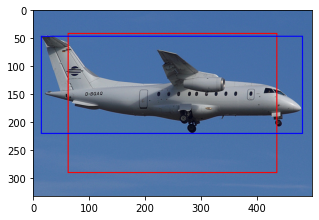

0.595508166969147
action: START
action: TRIGGER


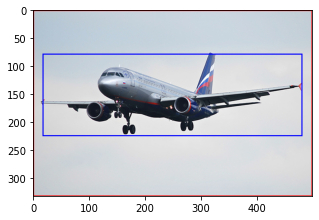

0.41054054054054057
action: START
action: down-right
action: down-right
action: up-left
action: down-left
action: up-left
action: up-left
action: TRIGGER


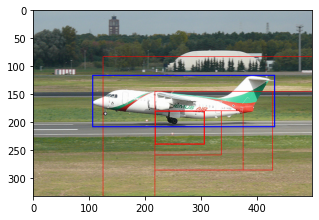

0.07781127524871873
action: START
action: TRIGGER


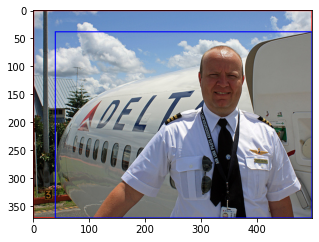

0.8278172043010753
action: START
action: up-left
action: up-left
action: up-left
action: up-left
action: up-left
action: TRIGGER


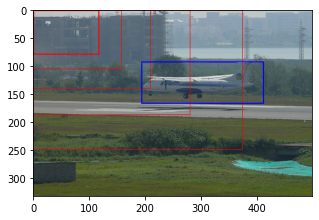

0.0
action: START
action: down-right
action: TRIGGER


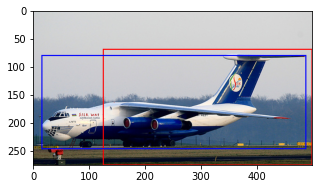

0.6332413146518048
action: START
action: center
action: down-right
action: up-right
action: up-left
action: up-right
action: down-left
action: TRIGGER
0.06798563898861813


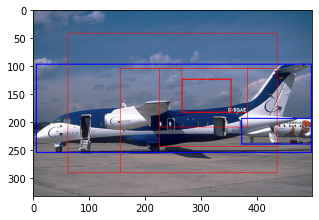

action: START
action: down-right
action: TRIGGER


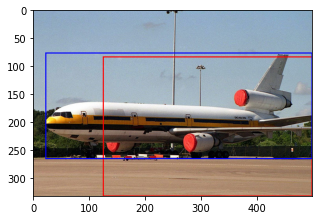

0.5918754581913839
action: START
action: up-right
action: center
action: up-right
action: up-right
action: down-left
action: down-left
action: down-right
action: down-left
action: TRIGGER


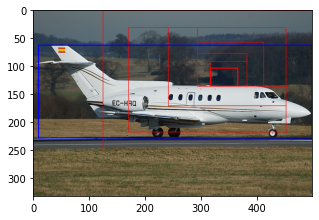

0.020122687415393248
action: START
action: TRIGGER


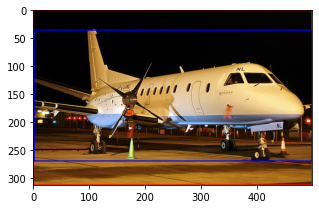

0.749297124600639
action: START
action: center
action: down-right
action: TRIGGER


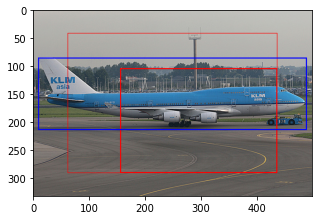

0.369356881676744
action: START
action: TRIGGER


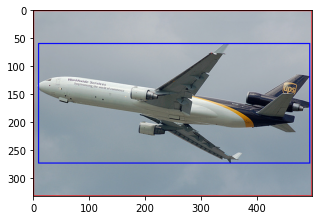

0.6288588588588588
action: START
action: TRIGGER


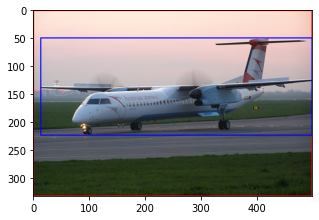

0.5118618618618619
action: START
action: center
action: TRIGGER


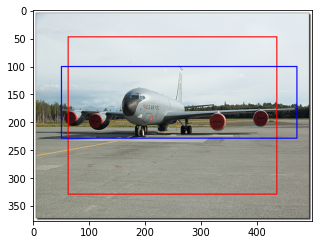

0.4321434314198424
action: START
action: center
action: center
action: center
action: center
action: TRIGGER


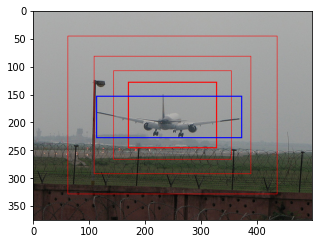

0.45149931849159475
action: START
action: up-right
action: TRIGGER


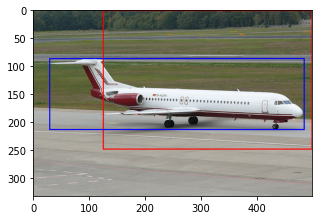

0.43731485950616583
action: START
action: center
action: center
action: TRIGGER


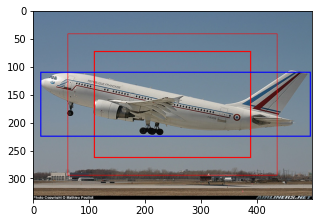

0.4211246497686844
action: START
action: center
action: center
action: TRIGGER


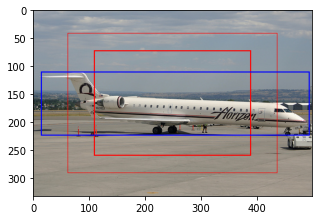

0.4235732797376633
action: START
action: TRIGGER


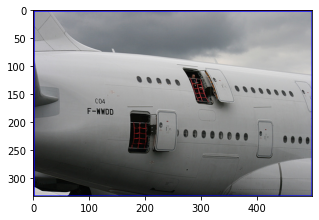

0.995003003003003
action: START
action: center
action: down-right
action: down-right
action: down-right
action: TRIGGER


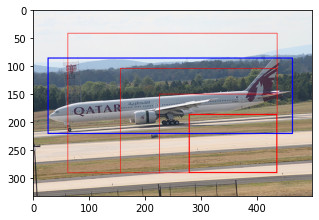

0.07814708043638008
action: START
action: center
action: down-right
action: down-left
action: up-left
action: TRIGGER


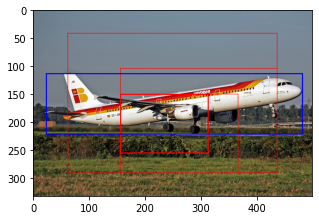

0.20492866407263294
action: START
action: TRIGGER


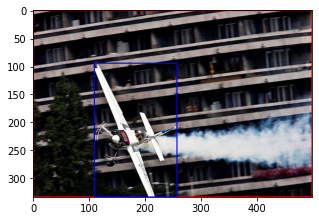

0.21413173652694611
action: START
action: TRIGGER
0.2981861861861862


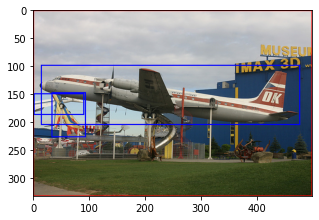

action: START
action: center
action: center
action: center
action: TRIGGER


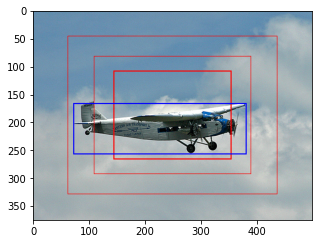

0.45342054927149505
action: START
action: TRIGGER


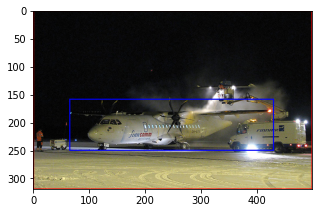

0.21110971786833857
action: START
action: down-right
action: TRIGGER
0.4528379489991774


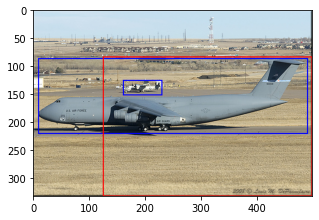

action: START
action: center
action: center
action: center
action: center
action: center
action: center
action: up-left
action: TRIGGER


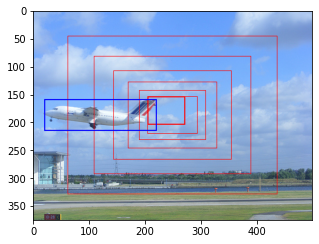

0.05185078496327236
action: START
action: center
action: down-right
action: TRIGGER


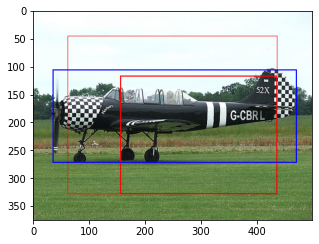

0.4933845352182877
action: START
action: TRIGGER


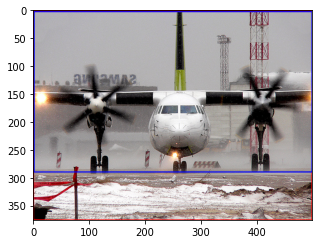

0.7644255319148936
action: START
action: TRIGGER


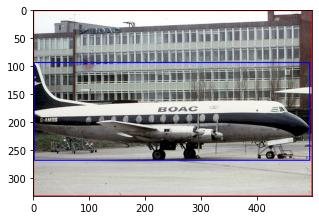

0.5232432432432432
action: START
action: center
action: up-right
action: TRIGGER
0.4108201795109873


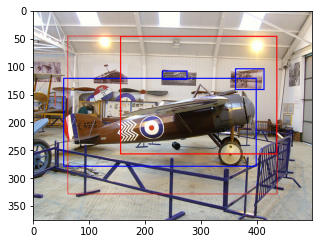

action: START
action: down-left
action: TRIGGER


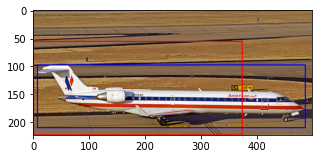

0.5488260370336153
action: START
action: down-left
action: down-left
action: TRIGGER


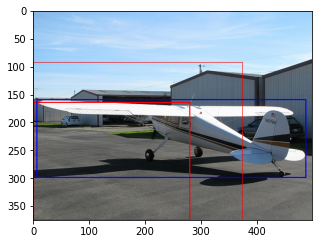

0.4134831710957165
action: START
action: up-right
action: TRIGGER


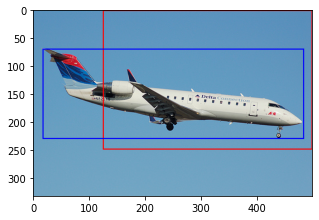

0.5232794344681888
action: START
action: center
action: TRIGGER


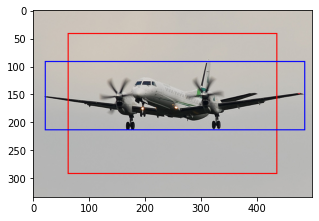

0.43795932319261666
action: START
action: center
action: TRIGGER


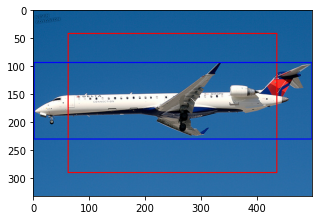

0.4667965578827732
action: START
action: center
action: center
action: TRIGGER


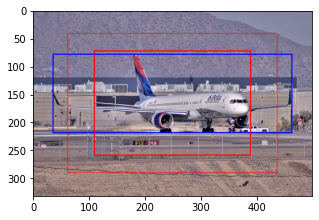

0.5396853504052306
action: START
action: TRIGGER


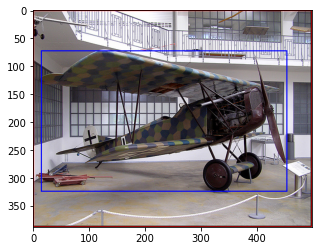

0.5728453608247422
action: START
action: TRIGGER


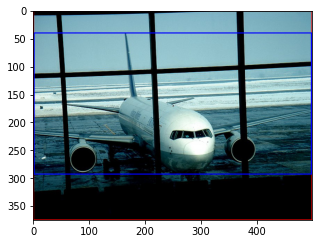

0.671968
action: START
action: TRIGGER


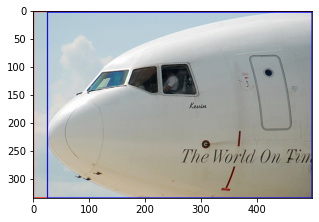

0.9471641791044776
action: START
action: TRIGGER


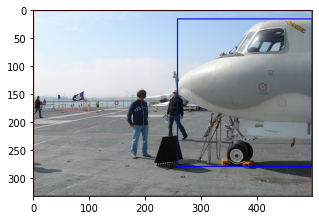

0.3851651651651652
action: START
action: TRIGGER


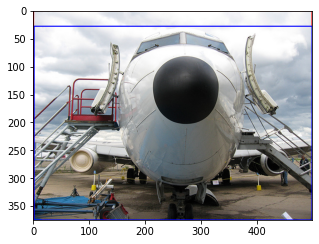

0.9234826666666667
action: START
action: center
action: center
action: center
action: TRIGGER


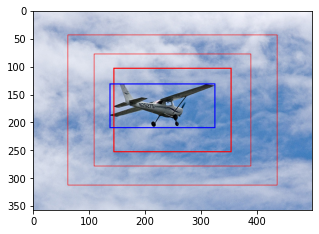

0.4464801416017141
action: START
action: TRIGGER


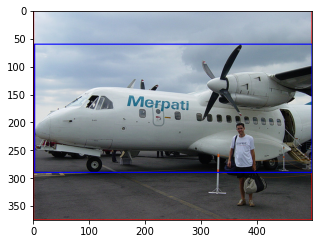

0.61088
action: START
action: center
action: center
action: TRIGGER


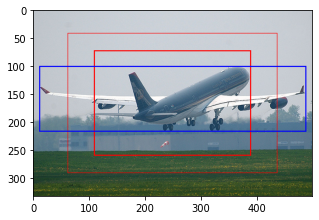

0.43329335635304506
action: START
action: TRIGGER


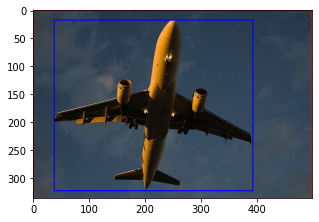

0.65025
action: START
action: center
action: TRIGGER


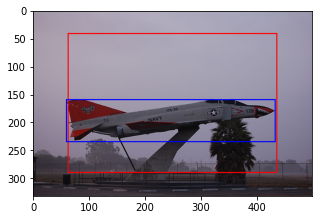

0.30204160123072976
action: START
action: center
action: center
action: center
action: TRIGGER


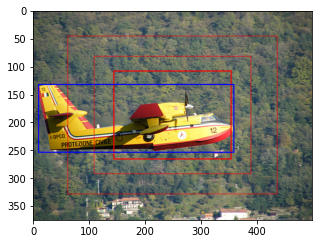

0.5105716212463802
action: START
action: center
action: TRIGGER


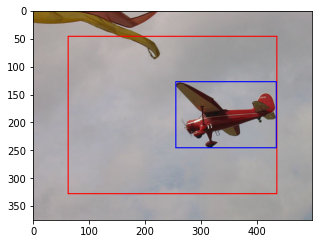

0.20367848699763594
action: START
action: center
action: center
action: down-right
action: up-right
action: up-right
action: up-right
action: up-left
action: TRIGGER


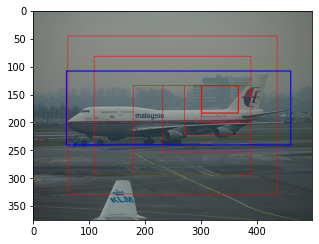

0.0625011660665311
action: START
action: center
action: center
action: TRIGGER


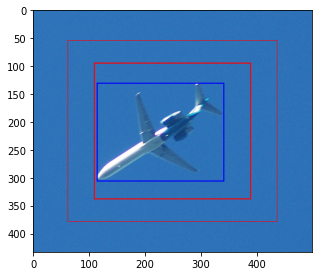

0.585263403535383
action: START
action: TRIGGER


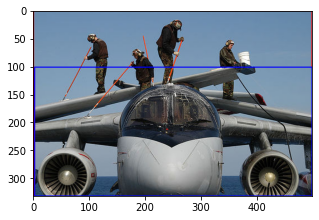

0.693
action: START
action: TRIGGER


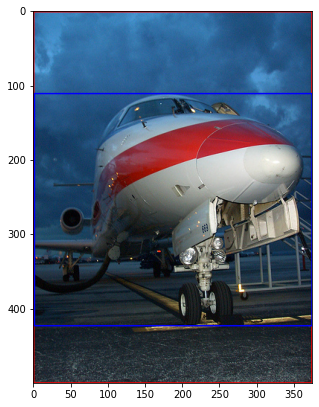

0.6243306666666667
action: START
action: center
action: down-right
action: TRIGGER


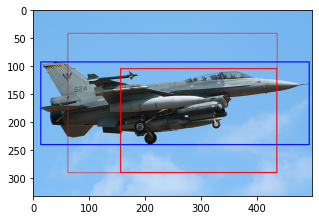

0.4483276657194764
action: START
action: down-right
action: up-left
action: up-left
action: center
action: up-left
action: up-left
action: up-left
action: TRIGGER


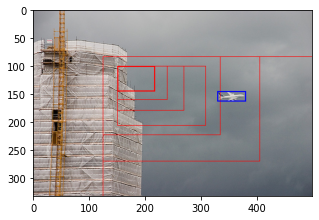

0.0
action: START
action: up-left
action: center
action: center
action: up-left
action: up-left
action: TRIGGER
0.11015977167853618


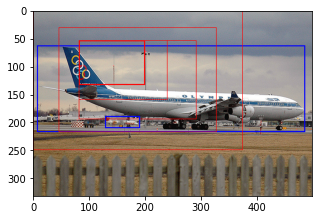

action: START
action: TRIGGER


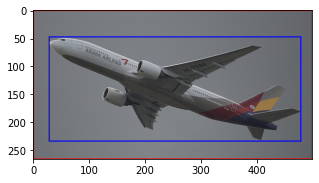

0.6355187969924811
action: START
action: TRIGGER


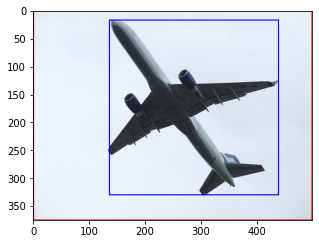

0.5074773333333333
action: START
action: TRIGGER


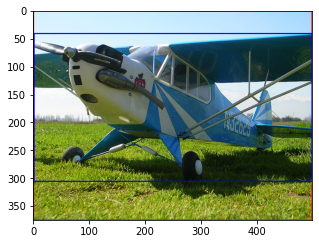

0.7052533333333333
action: START
action: center
action: TRIGGER


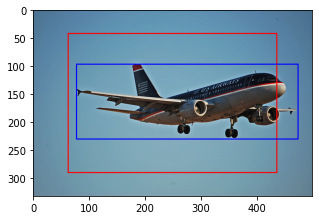

0.49150485436893204
action: START
action: center
action: center
action: center
action: center
action: down-right
action: TRIGGER


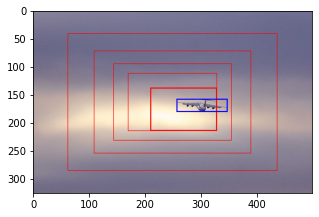

0.1725
action: START
action: center
action: TRIGGER


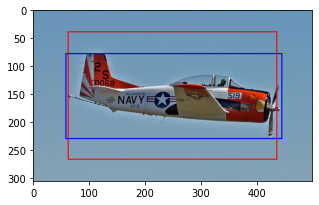

0.6529978148046982
action: START
action: center
action: center
action: down-right
action: down-left
action: down-right
action: up-left
action: up-left
action: down-left
action: down-right
action: TRIGGER
action: TRIGGER


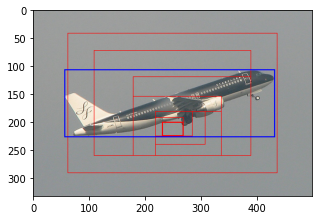

0.020825569414911108
action: START
action: TRIGGER


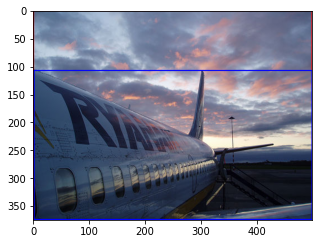

0.710576
action: START
action: TRIGGER


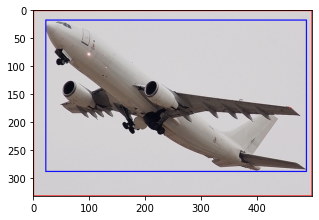

0.7645405405405405
action: START
action: center
action: center
action: down-right
action: TRIGGER
0.3037876550502067


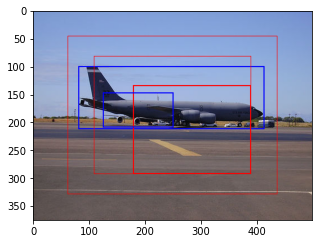

action: START
action: TRIGGER
0.3082882882882883


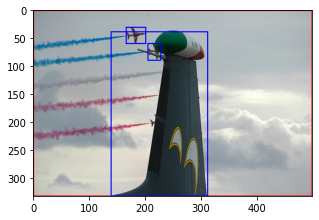

action: START
action: center
action: center
action: center
action: center
action: center
action: TRIGGER


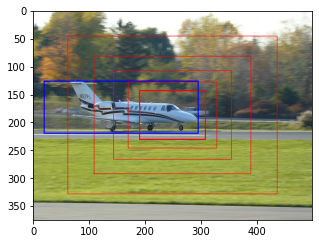

0.2879215464935798
action: START
action: center
action: TRIGGER


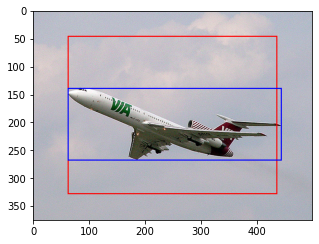

0.4530257908636287
action: START
action: center
action: up-right
action: TRIGGER


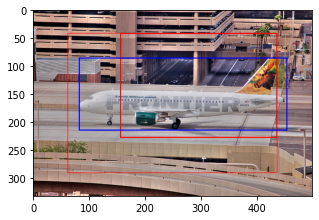

0.5662951307610027
action: START
action: center
action: center
action: down-left
action: up-left
action: TRIGGER


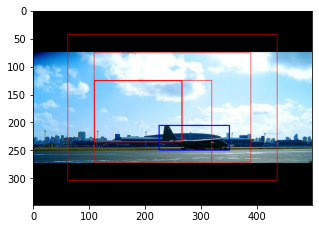

0.057705518662697505
action: START
action: center
action: center
action: up-right
action: TRIGGER


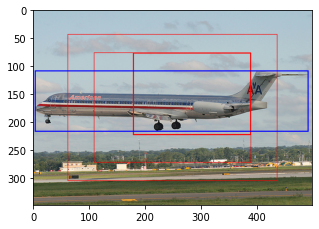

0.3744058084261249
action: START
action: center
action: center
action: center
action: center
action: center
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
0.031078224101479916


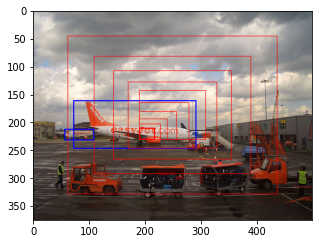

action: START
action: TRIGGER
0.45633066666666666


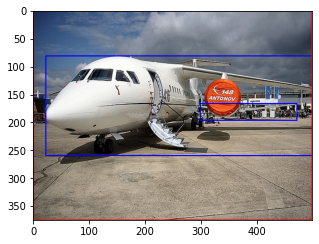

action: START
action: TRIGGER
0.694608


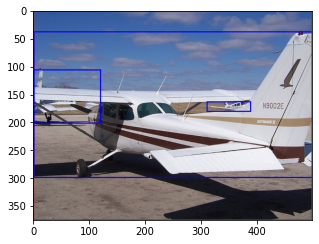

action: START
action: TRIGGER


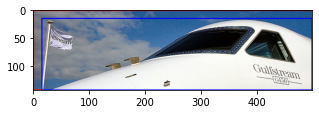

0.875034965034965
action: START
action: TRIGGER


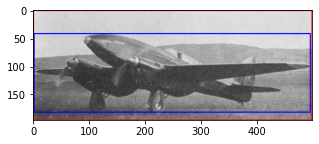

0.7136326530612245
action: START
action: center
action: center
action: TRIGGER


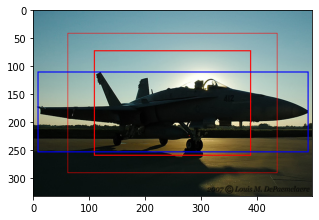

0.492238820495353
action: START
action: TRIGGER


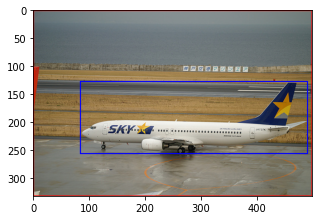

0.3185585585585586
action: START
action: TRIGGER


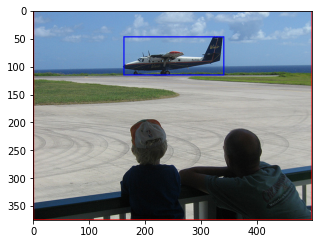

0.06624
action: START
action: center
action: center
action: center
action: center
action: down-right
action: TRIGGER
0.2536115569823435


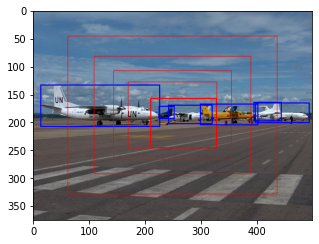

action: START
action: TRIGGER


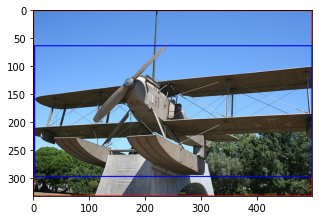

0.7028828828828829
action: START
action: down-right
action: down-right
action: TRIGGER


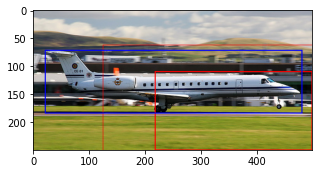

0.2747900909027826
action: START
action: TRIGGER
0.6533453453453454


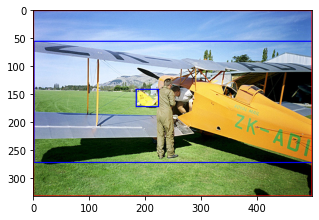

action: START
action: TRIGGER


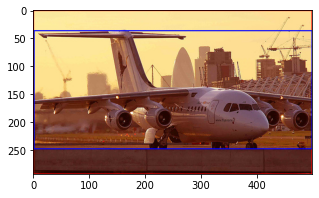

0.7221023890784983
action: START
action: TRIGGER


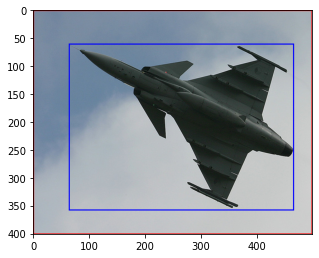

0.5989725685785536
action: START
action: TRIGGER


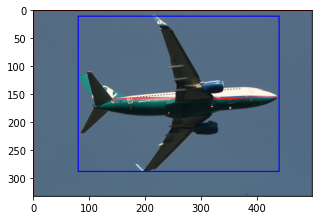

0.6049189189189189
action: START
action: down-left
action: TRIGGER
0.60938757615218


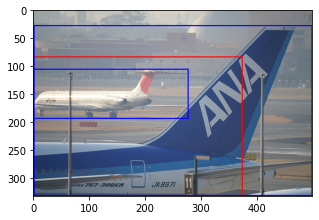

action: START
action: center
action: center
action: center
action: center
action: center
action: up-right
action: TRIGGER
0.07570398889734521


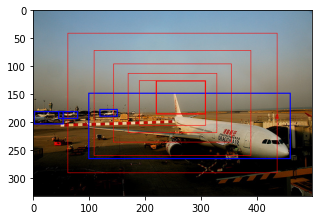

action: START
action: up-left
action: up-left
action: TRIGGER


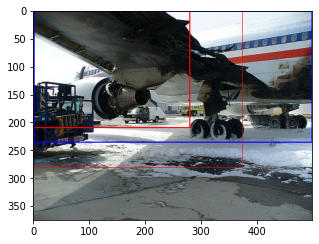

0.4969640354974311
action: START
action: center
action: TRIGGER


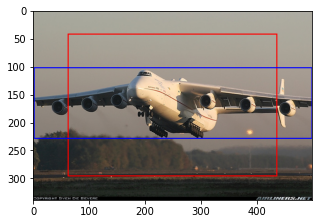

0.4290617848970252
action: START
action: TRIGGER


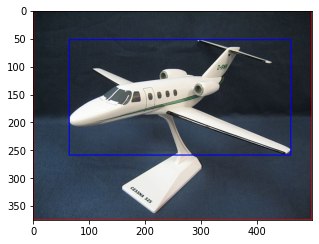

0.439392
action: START
action: TRIGGER
0.496336


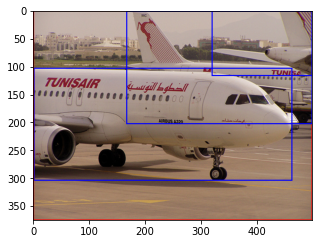

action: START
action: center
action: center
action: TRIGGER


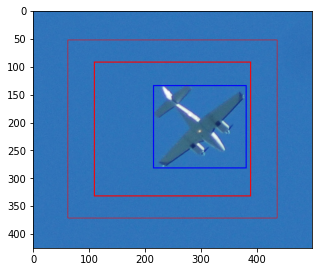

0.36648873072360616
action: START
action: TRIGGER


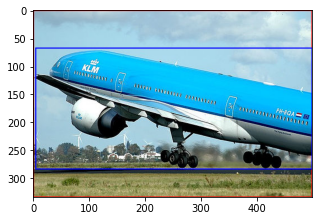

0.6445029940119761
action: START
action: TRIGGER
0.913792


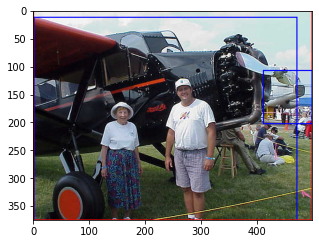

action: START
action: TRIGGER


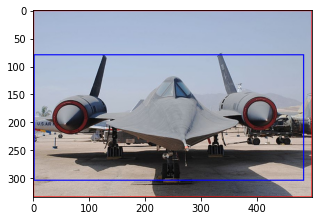

0.6520958083832336
action: START
action: center
action: center
action: TRIGGER


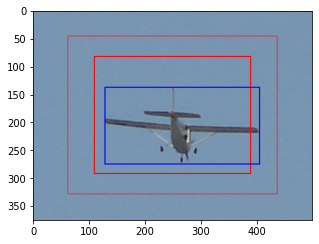

0.5906106047241008
action: START
action: up-right
action: down-right
action: up-right
action: center
action: up-right
action: TRIGGER


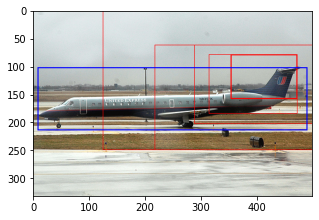

0.11725581968222687
action: START
action: center
action: up-left
action: center
action: up-left
action: center
action: TRIGGER
0.18418825122735738


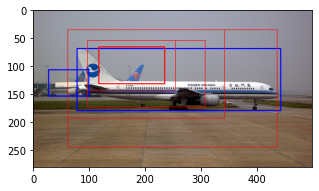

action: START
action: center
action: TRIGGER


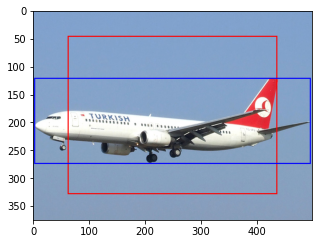

0.46229151559100795
action: START
action: center
action: center
action: TRIGGER
0.514003838311143


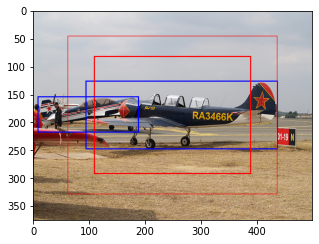

action: START
action: center
action: center
action: TRIGGER


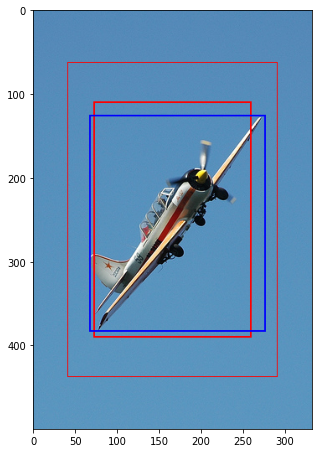

0.8290715164775058
action: START
action: down-left
action: center
action: TRIGGER


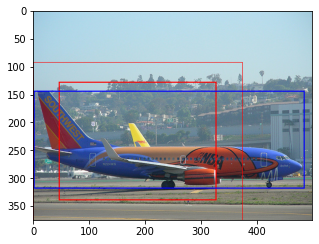

0.517463933181473
action: START
action: center
action: TRIGGER


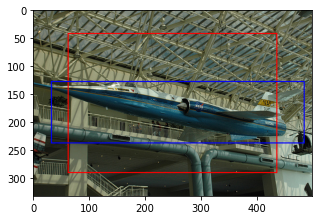

0.40602229830567993
action: START
action: up-left
action: up-right
action: up-left
action: center
action: TRIGGER


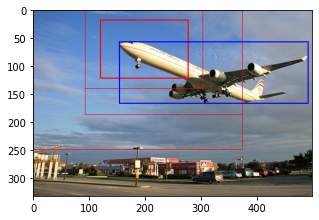

0.17777777777777778
action: START
action: down-left
action: TRIGGER


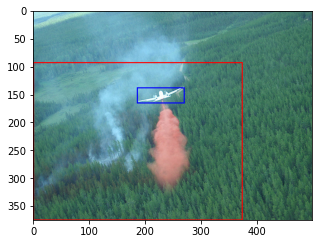

0.022505910165484633
action: START
action: center
action: center
action: up-left
action: up-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left


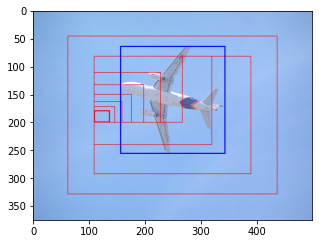

0.0
action: START
action: center
action: center
action: center
action: down-right
action: TRIGGER


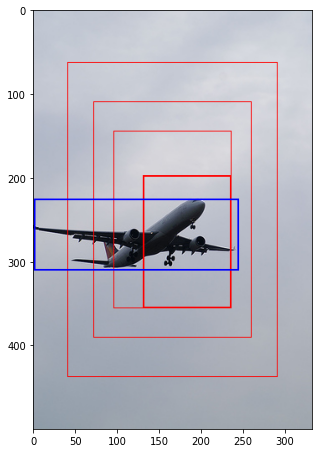

0.31420524555535995
action: START
action: up-right
action: down-right
action: up-right
action: up-right
action: down-left
action: down-right
action: down-right
action: down-left
action: down-left
action: down-left
action: down-left


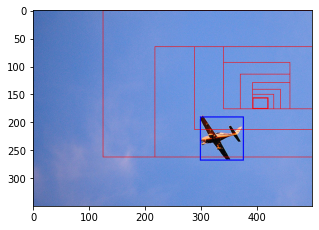

0.0
action: START
action: center
action: center
action: TRIGGER


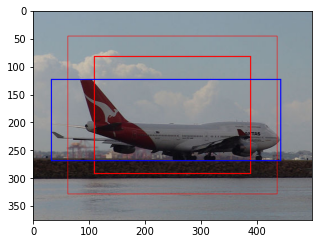

0.5250588717108631
action: START
action: center
action: center
action: center
action: center
action: TRIGGER


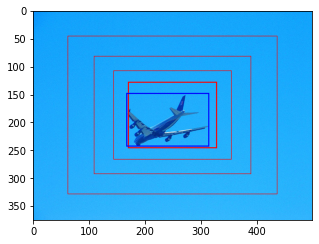

0.7232110043576416
action: START
action: center
action: center
action: center
action: down-left
action: down-right
action: down-right
action: down-right
action: up-left
action: TRIGGER


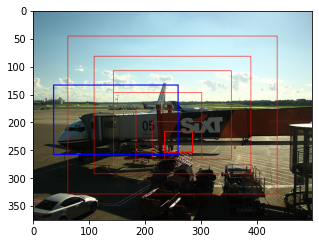

0.03277218159238306
action: START
action: center
action: center
action: TRIGGER


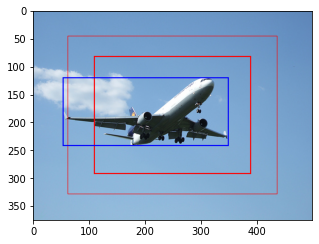

0.446553871389083
action: START
action: center
action: center
action: down-left
action: TRIGGER
0.31528150134048255


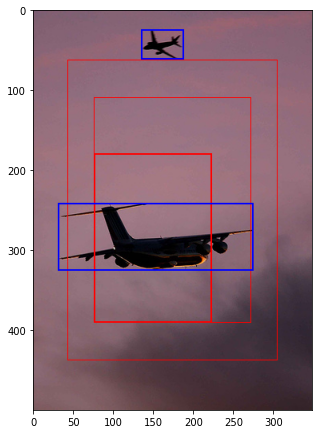

action: START
action: TRIGGER


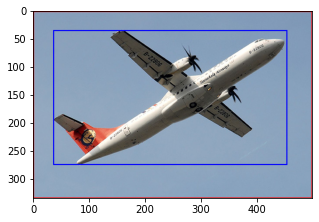

0.6028597014925373
action: START
action: TRIGGER


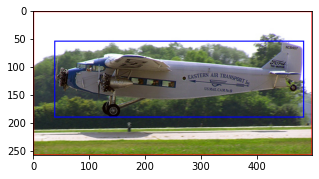

0.4747209302325581
action: START
action: up-right
action: TRIGGER


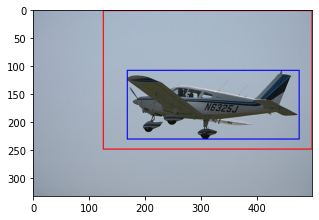

0.4103453815261044
action: START
action: center
action: up-left
action: TRIGGER


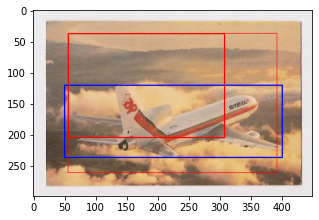

0.3458340704050946
action: START
action: down-left
action: up-left
action: up-right
action: TRIGGER


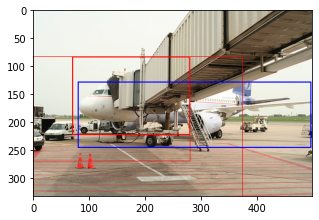

0.3194799979922702
action: START
action: center
action: center
action: center
action: up-right
action: TRIGGER


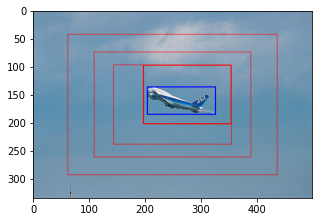

0.36720802483878673
action: START
action: up-left
action: up-right
action: down-left
action: TRIGGER


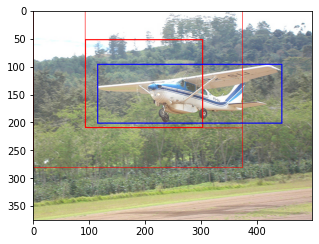

0.4140111593304402
action: START
action: center
action: center
action: center
action: TRIGGER


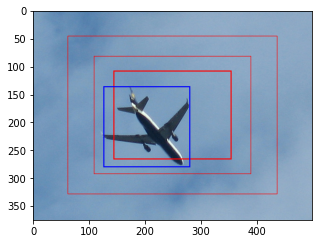

0.47056647643204397
action: START
action: center
action: TRIGGER
0.42705481599130635


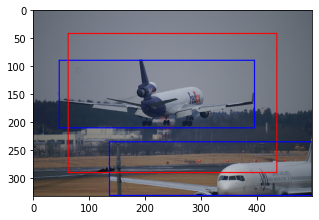

action: START
action: down-left
action: down-left
action: TRIGGER


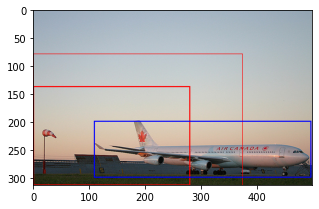

0.24244285036425042
action: START
action: TRIGGER


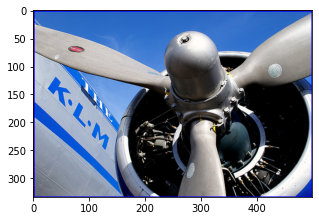

0.9950119760479041
action: START
action: up-right
action: down-right
action: down-right
action: TRIGGER


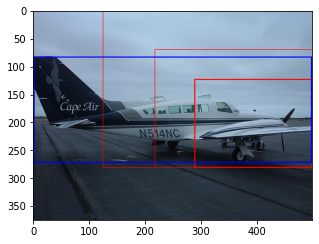

0.32536133929499844
action: START
action: down-right
action: down-right
action: down-right
action: down-left
action: up-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left
action: down-left


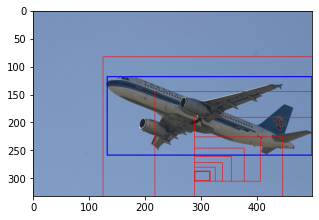

0.0
action: START
action: center
action: down-right
action: down-left
action: TRIGGER


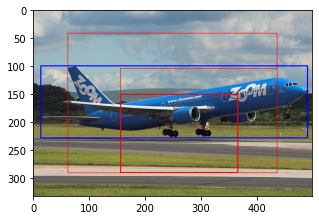

0.2212150971440705
action: START
action: center
action: center
action: center
action: center
action: down-right
action: up-left
action: TRIGGER
0.2572713643178411


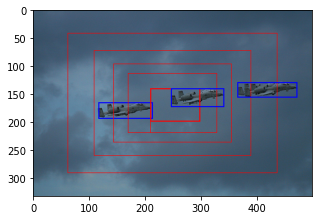

action: START
action: up-left
action: TRIGGER


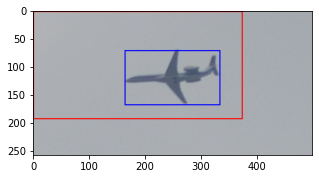

0.2315440414507772
action: START
action: TRIGGER


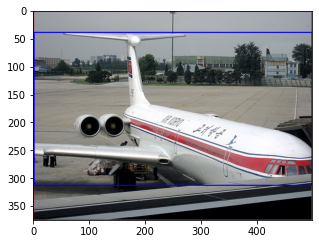

0.7292053333333334
action: START
action: center
action: center
action: up-left
action: TRIGGER


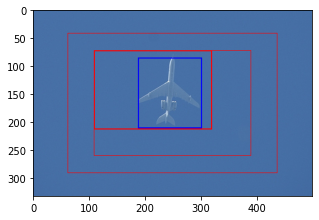

0.482807300594938
action: START
action: center
action: center
action: TRIGGER


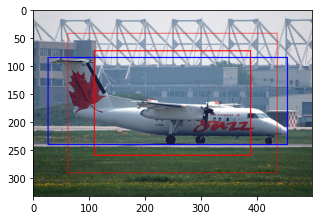

0.578803741750961
action: START
action: center
action: TRIGGER


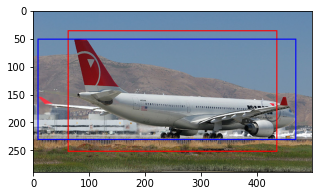

0.6970260223048327
action: START
action: up-left
action: center
action: center
action: up-left
action: center
action: TRIGGER


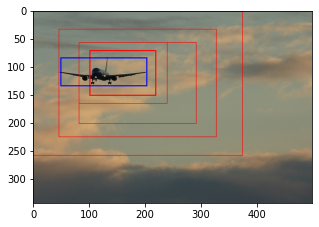

0.42738589211618255
action: START
action: TRIGGER


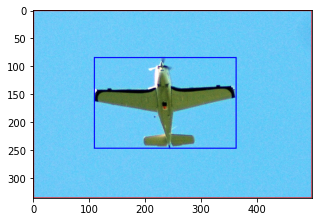

0.2474107142857143
action: START
action: up-left
action: center
action: up-left
action: up-left
action: down-right
action: up-left
action: up-left
action: down-left
action: down-left
action: down-left
action: down-left


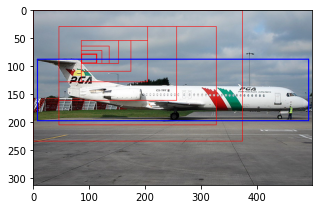

0.004124546576073947
action: START
action: center
action: center
action: center
action: down-left
action: TRIGGER


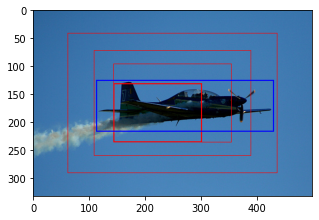

0.42122884245768494
action: START
action: TRIGGER
0.9048648648648648


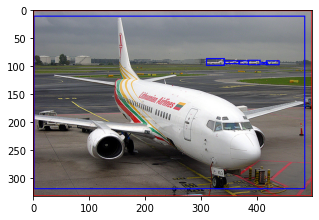

action: START
action: center
action: center
action: down-right
action: TRIGGER


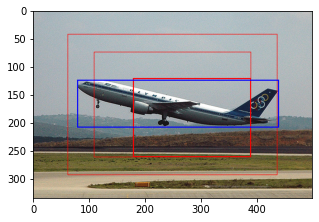

0.421990070821863
action: START
action: TRIGGER
0.5485333333333333


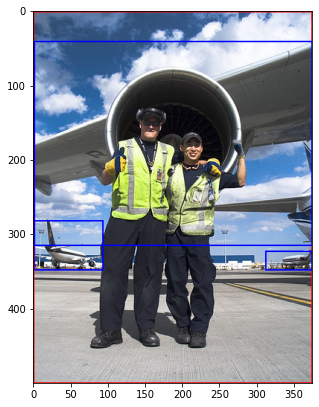

action: START
action: up-left
action: up-right
action: up-right
action: TRIGGER
0.40897527884678103


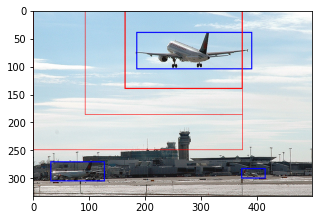

action: START
action: TRIGGER


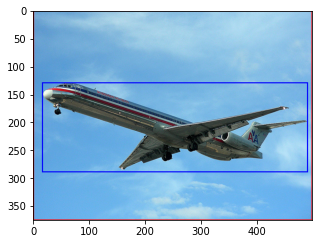

0.40618666666666664
action: START
action: center
action: up-right
action: TRIGGER


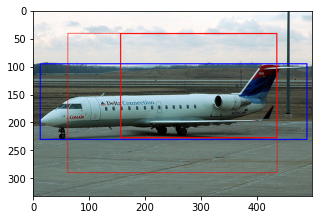

0.46531288129684506
action: START
action: TRIGGER


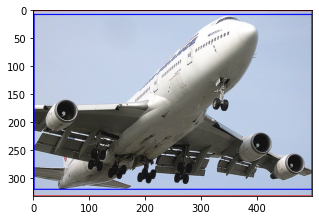

0.9410570570570571
action: START
action: down-left
action: down-left
action: TRIGGER


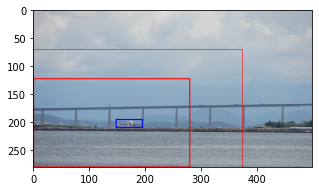

0.01611495333378097
action: START
action: center
action: TRIGGER
0.3520589133447652


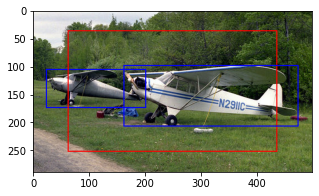

action: START
action: center
action: center
action: center
action: TRIGGER


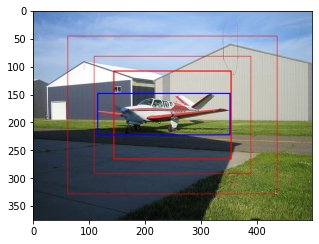

0.4413876608565877
action: START
action: center
action: TRIGGER


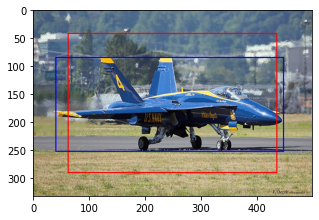

0.6369602798102436
action: START
action: center
action: TRIGGER


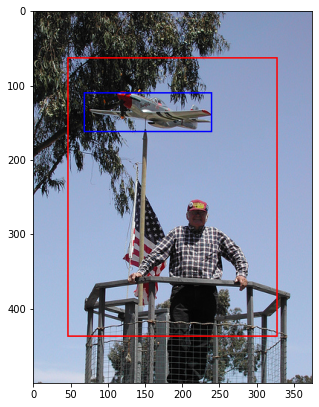

0.0862033096926714
action: START
action: center
action: center
action: center
action: down-right
action: TRIGGER
0.28380877854449743


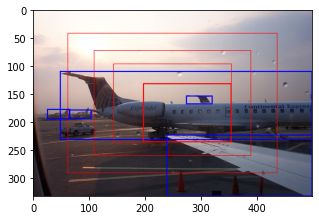

action: START
action: TRIGGER


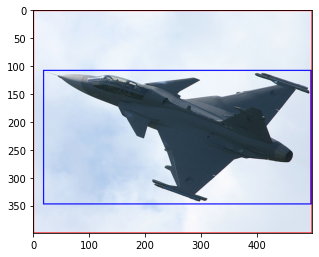

0.5774436090225564
action: START
action: TRIGGER
0.413664


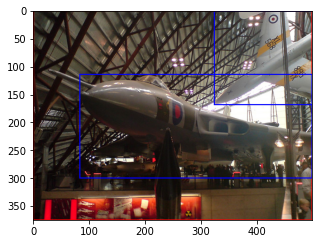

action: START
action: center
action: center
action: down-right
action: down-right
action: down-right
action: down-left
action: TRIGGER


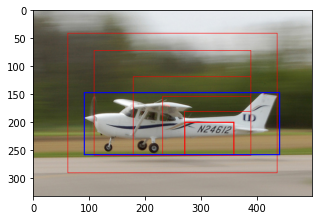

0.13327072916931043
action: START
action: center
action: center
action: down-right
action: up-right
action: TRIGGER


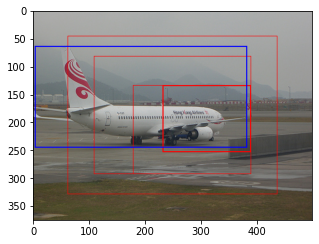

0.2366670902698352
action: START
action: up-right
action: down-left
action: TRIGGER


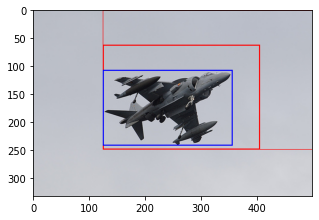

0.5960378327973053
action: START
action: up-left
action: center
action: TRIGGER


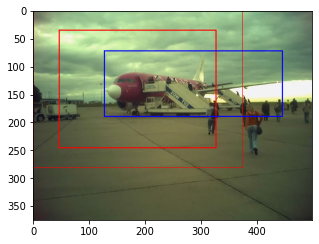

0.3225008158381377
action: START
action: down-left
action: up-left
action: up-left
action: down-left
action: TRIGGER


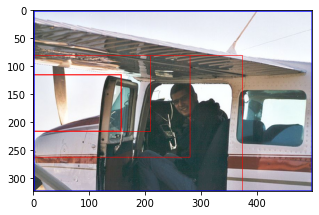

0.09929377042268367
action: START
action: TRIGGER


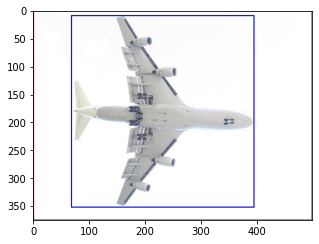

0.6000213333333333
action: START
action: TRIGGER


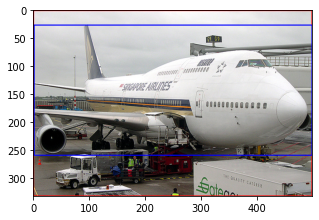

0.7012972972972973
action: START
action: TRIGGER


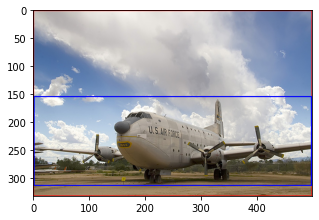

0.47855855855855856
action: START
action: TRIGGER


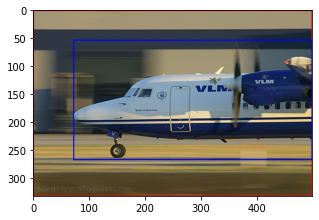

0.5526726726726727
action: START
action: TRIGGER


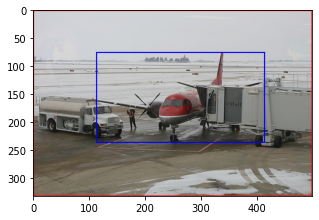

0.29383783783783785
action: START
action: center
action: TRIGGER
0.14325333333333334


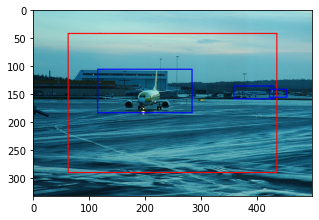

action: START
action: TRIGGER


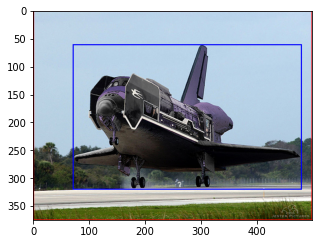

0.5663466666666667
action: START
action: TRIGGER
0.5994666666666667


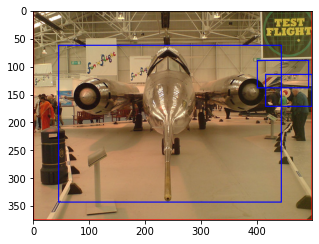

action: START
action: TRIGGER


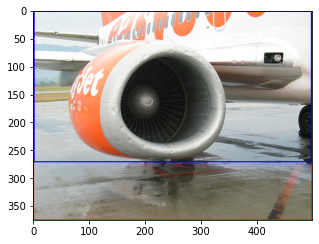

0.71712
action: START
action: center
action: down-right
action: TRIGGER


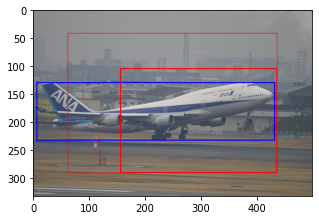

0.4227332090921097
action: START
action: TRIGGER


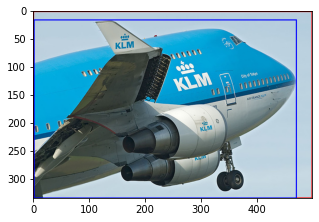

0.8998208955223881
action: START
action: down-left
action: down-left
action: TRIGGER


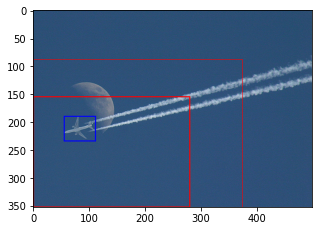

0.04610158524749272
action: START
action: TRIGGER
0.74672


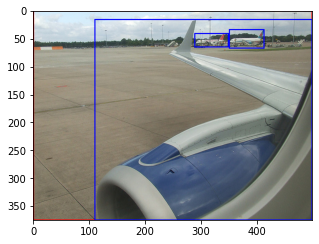

action: START
action: TRIGGER


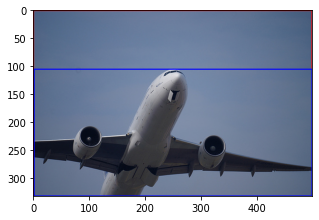

0.6833153153153153
action: START
action: center
action: TRIGGER
0.5544924762981648


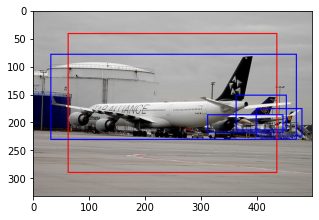

action: START
action: TRIGGER


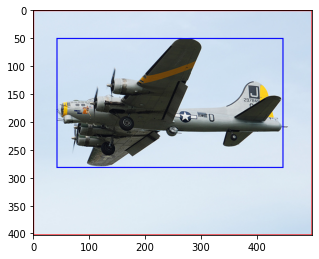

0.467454094292804
average IoU is: 0.4217161058694017


In [26]:
!rm -rf testing
!mkdir testing
#Testing
if __name__ == "__main__":
   
    ######## PATHS definition ########

    # path of pascal voc test
    path_voc_test = "./VOC2012"
    # model name of the weights
    #model_name = "model6.h5"
    # path of folder where the weights are
    weights_path = "../gdrive/My Drive/simple_10step_wotargetchange"
    # path of where to store visualizations of search sequences
    path_testing_folder = './testing'
    epoch_num = 2
    ######## PARAMETERS ########

    # Class category of PASCAL that the RL agent will be searching
    class_object = 1
    # 1 if you want to obtain visualizations of the search for objects
    bool_draw = 1
    # Scale of subregion for the hierarchical regions (to deal with 2/4, 3/4)
    scale_subregion = float(3)/4
    scale_mask = float(1)/(scale_subregion*4)
    # Number of steps that the agent does at each image
    number_of_steps = 10
    # Only search first object
    only_first_object = 1
    IoU_storage = []

    ######## MODELS ########

    model_vgg = VGG16(weights='imagenet', include_top=True)
    #sgd = SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=True)
    #model_vgg.compile(optimizer=sgd, loss='categorical_crossentropy')
    #print(model_vgg.layers)
    model = get_q_network(weights_path, class_object, epoch_num)

    ######## LOAD IMAGE NAMES ########

    image_names = np.array([load_images_names_in_data_set('aeroplane_val', path_voc_test)])
  
    ######## LOAD IMAGES ########
   
    images = get_all_images(image_names, path_voc_test)


    for j in range(np.size(image_names)):

      image_1 = np.array(images[j])
      # init drawing for visualization
      background = Image.new('RGBA', (10000, 2000), (255, 255, 255, 255))
      draw = ImageDraw.Draw(background)
      background2 = Image.fromarray(image_1)
      draw2 = ImageDraw.Draw(background2)
      visualize = False
      image_name = image_names[0][j]
      
      annotation = get_bb_of_gt_from_pascal_xml_annotation(image_name, path_voc_test)
      
      gt_masks = generate_bounding_box_from_annotation(annotation, image_1.shape)
      array_classes_gt_objects = get_ids_objects_from_annotation(annotation)
      
      absolute_status = 1
      select_status = 1
      finish_step = 0
      indices = (np.asarray(np.where(array_classes_gt_objects == class_object))).flatten()
      object_numbers= len(indices)

      for k in range(object_numbers):
        m = int(indices[k])
        box_area2 = [annotation[m][1],annotation[m][3],annotation[m][2],annotation[m][4]]
        box_color2 = (0, 0, 255)
        if k==(object_numbers-1) and visualize:
            finish_step =1
        draw_sequences_test_box(draw2, background2, box_area2, box_color2, path_testing_folder, image_name,
                                      bool_draw , finish_step, line_width=2 )

        if (select_status == 1):

          size_mask = (image_1.shape[0], image_1.shape[1])
          original_shape = size_mask
          image_for_search = image_1
          region_mask = np.ones([image_1.shape[0], image_1.shape[1]])
          # offset of the region observed at each time step
          offset = (0, 0)
          # absolute status is a boolean we indicate if the agent will continue
          # searching object or not. If the first object already covers the whole
          # image, we can put it at 0 so we do not further search there
          action = 0
          step = 0
          qval = [[0]]
          region_image = image_for_search
          region_mask = np.ones([image_1.shape[0], image_1.shape[1]])
          # we run the agent if the maximum number of steps has not been reached and
          # if the boolean
          while (step < number_of_steps) and (absolute_status == 1):
              
              iou = 0
              # we init history vector as we are going to find another object
              history_vector = np.zeros([24])
              state = get_state(region_image, history_vector, model_vgg)
              status = 1
              draw_sequences_test(step, action, qval, draw, region_image, background, path_testing_folder,
                                  region_mask, image_name, bool_draw)
              size_mask = (image_1.shape[0], image_1.shape[1])
              original_shape = size_mask
              region_mask = np.ones([image_1.shape[0], image_1.shape[1]])
              while (status == 1) & (step < number_of_steps):
                  step += 1
                  qval = model.predict(state.T, batch_size=1)
                  action = (np.argmax(qval))+1
                  # movement action, make the proper zoom on the image
                  if action != 6:
                      region_mask = np.zeros(original_shape)
                      size_mask = (size_mask[0] * scale_subregion, size_mask[1] * scale_subregion)
                      if action == 1:
                          offset_aux = (0, 0)
                      elif action == 2:
                          offset_aux = (0, size_mask[1] * scale_mask)
                          offset = (offset[0], offset[1] + size_mask[1] * scale_mask)
                      elif action == 3:
                          offset_aux = (size_mask[0] * scale_mask, 0)
                          offset = (offset[0] + size_mask[0] * scale_mask, offset[1])
                      elif action == 4:
                          offset_aux = (size_mask[0] * scale_mask,
                                        size_mask[1] * scale_mask)
                          offset = (offset[0] + size_mask[0] * scale_mask,
                                    offset[1] + size_mask[1] * scale_mask)
                      elif action == 5:
                          offset_aux = (size_mask[0] * scale_mask / 2,
                                        size_mask[1] * scale_mask / 2)
                          offset = (offset[0] + size_mask[0] * scale_mask / 2,
                                    offset[1] + size_mask[1] * scale_mask / 2)
                      region_image = region_image[int(offset_aux[0]):int(offset_aux[0] + size_mask[0]),
                                      int(offset_aux[1]):int(offset_aux[1] + size_mask[1])]
                      region_mask[int(offset[0]):int(offset[0] + size_mask[0]), 
                                  int(offset[1]):int(offset[1] + size_mask[1])] = 1
                      draw_sequences_test(step, action, qval, draw, region_image, background, path_testing_folder,
                                          region_mask, image_name, bool_draw)
                      box_area = ((int(offset[1]), int(offset[0])),
                                                    (int(offset[1] + size_mask[1]), int(offset[0] + size_mask[0])))
                      box_color = (255, 0, 0)
                      draw_sequences_test_box(draw2, background2, box_area, box_color, path_testing_folder, 
                                              image_name, bool_draw, finish_step, line_width=1)
                  # trigger action
                  if action == 6:
                      draw_sequences_test(step, action, qval, draw, region_image, background, path_testing_folder,
                                                      region_mask, image_name, bool_draw)
                      box_area = ((int(offset[1]), int(offset[0])),
                                                    (int(offset[1] + size_mask[1]), int(offset[0] + size_mask[0])))
                      box_color = (255, 0, 0)
                      draw_sequences_test_box(draw2, background2, box_area, box_color, path_testing_folder, image_name,
                                                    bool_draw , finish_step, line_width=2 )
                      status = 0
                      select_status = 0
                      if step == 1:
                          absolute_status = 0
                      if only_first_object == 1:
                          absolute_status = 0
                      image_for_search = mask_image_with_mean_background(region_mask, image_for_search)
                      region_image = image_for_search
                  
                  if step >= number_of_steps :
                      draw_sequences_test(step, action, qval, draw, region_image, background, path_testing_folder,
                                                      region_mask, image_name, bool_draw)
                      box_area = ((int(offset[1]), int(offset[0])),
                                                    (int(offset[1] + size_mask[1]), int(offset[0] + size_mask[0])))
                      box_color = (255, 0, 0)
                      draw_sequences_test_box(draw2, background2, box_area, box_color, path_testing_folder, image_name,
                                                    bool_draw ,finish_step, line_width=2 )
                      select_status = 0

                  history_vector = update_history_vector(history_vector, action)
                  new_state = get_state(region_image, history_vector, model_vgg)
                  state = new_state
                    
          box_area2 = [annotation[m][1],annotation[m][3],annotation[m][2],annotation[m][4]]
          box_color2 = (0, 0, 255)
          visualize = True
          if k==(object_numbers-1) and visualize:
            finish_step =1
            draw_sequences_test_box(draw2, background2, box_area2, box_color2, path_testing_folder, image_name,
                                        bool_draw , finish_step, line_width=2 )
          

          tmp = []
          for index_o in range(np.size(array_classes_gt_objects)):
            if (array_classes_gt_objects[index_o] == class_object):
              gt_mask = gt_masks[:, :, index_o]
              happy = calculate_iou(region_mask, gt_mask)
              tmp.append(happy)

          iou_result = max(tmp)
          print('iou:' , iou_result)
          IoU_storage.append(iou_result)

    print('average IoU is:',np.average(IoU_storage))